In [1]:
import matplotlib.pyplot as plt
import numpy as np
import patchify as pat
import cv2
# import threshold_multiotsu
from skimage.filters import threshold_multiotsu
import random
import os


from skimage import exposure

import pySPM

Loaded image: dummy_SLSQA_003 with shape (256, 512)
Loaded image: dummy_SLSQC_006 with shape (256, 512)
Loaded image: dummy_SLSQH_012 with shape (256, 512)
Loaded image: real_SLSQA_012 with shape (256, 512)
Loaded image: real_SLSQC_141 with shape (256, 512)
Loaded image: real_SLSQH_008 with shape (256, 512)
Successfully loaded 6 images
dummy_SLSQA_003


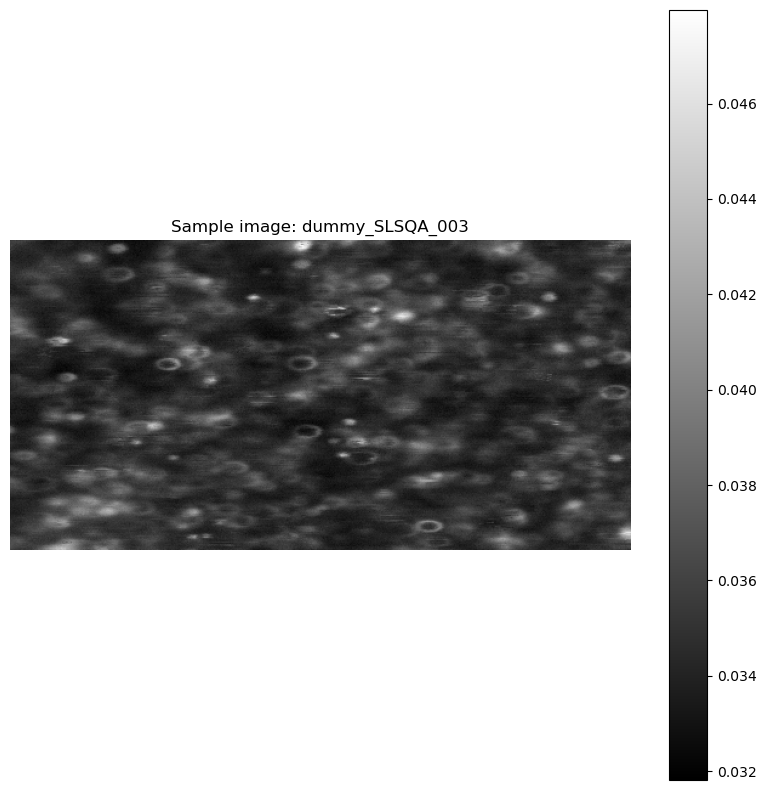

In [6]:
# Define directory path where images are stored
image_dir = 'SLSQ_traps' 

# Dictionary to store the images
trap_images = {}

# Check if the directory exists
if os.path.exists(image_dir):
    # List all files in the directory
    files = os.listdir(image_dir)
    
    # Filter for .sxm files (assuming they have common image extensions)
    ext = '.sxm'
    image_files = [f for f in files if f.lower().endswith(ext)]
    
    # Load each image into the dictionary
    for img_file in image_files:
        # Read the image
        img_path = os.path.join(image_dir, img_file)
        try:
            # Open image
            img = pySPM.SXM(img_path).get_channel('Excitation').pixels
            # Use filename without extension as the key
            key = os.path.splitext(img_file)[0]
            trap_images[key] = img
            print(f"Loaded image: {key} with shape {img.shape}")
        except Exception as e:
            print(f"Error loading {img_file}: {e}")
    
    print(f"Successfully loaded {len(trap_images)} images")
else:
    print(f"Directory {image_dir} does not exist")

# Display a sample image if any were loaded
if trap_images:
    # Pick first image to display
    sample_key = next(iter(trap_images))
    print(sample_key)
    plt.figure(figsize=(10, 10))
    plt.imshow(trap_images[sample_key], cmap='gray')
    plt.title(f"Sample image: {sample_key}")
    plt.colorbar()
    plt.axis('off')
    plt.show()

Loaded image: 1 with shape (770, 730, 3)
Loaded image: 2 with shape (770, 733, 3)
Loaded image: 3 with shape (770, 733, 3)
Loaded image: 4 with shape (770, 769, 3)
Loaded image: 5 with shape (770, 769, 3)
Loaded image: 6 with shape (770, 769, 3)
Successfully loaded 6 images
1


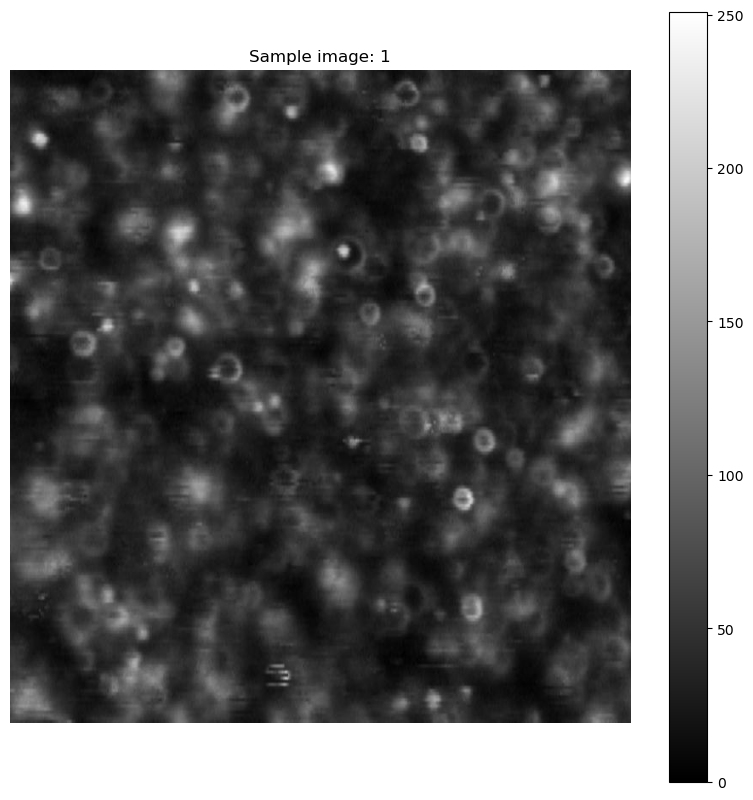

In [7]:
# Define directory path where images are stored
image_dir = 'SLSQ_traps/jpeg versions' 

# Dictionary to store the images
trap_images = {}

# Check if the directory exists
if os.path.exists(image_dir):
    # List all files in the directory
    files = os.listdir(image_dir)
    
    # Filter for .sxm files (assuming they have common image extensions)
    ext = '.jpeg'
    image_files = [f for f in files if f.lower().endswith(ext)]
    
    # Load each image into the dictionary
    for img_file in image_files:
        # Read the image
        img_path = os.path.join(image_dir, img_file)
        try:
            # Open image
            img = plt.imread(img_path)
            # Use filename without extension as the key
            key = os.path.splitext(img_file)[0]
            trap_images[key] = img
            print(f"Loaded image: {key} with shape {img.shape}")
        except Exception as e:
            print(f"Error loading {img_file}: {e}")
    
    print(f"Successfully loaded {len(trap_images)} images")
else:
    print(f"Directory {image_dir} does not exist")

# Display a sample image if any were loaded
if trap_images:
    # Pick first image to display
    sample_key = next(iter(trap_images))
    print(sample_key)
    plt.figure(figsize=(10, 10))
    plt.imshow(trap_images[sample_key], cmap='gray')
    plt.title(f"Sample image: {sample_key}")
    plt.colorbar()
    plt.axis('off')
    plt.show()

In [2]:
def generate_synthetic_data(n, num_donuts_range_max=(5, 50), num_donuts_range_min = (1,10), num_circles_range=(3, 25), 
                          radius_range_circle=(5, 10), radius_range_donuts=(10,30), 
                          thickness_range=(2, 5), intensity_range_init=(0.2, 0.5),
                          intensity_range_2 = (0.3,1),
                          gaussian_sigma_range=(0.5, 5.0)):
    """
    Generate synthetic data with filtered donuts and circles of varying intensities.
    Also returns bounding box coordinates for each donut.
    
    Args:
        n: Resolution of the square image
        num_donuts_range: Range for number of donuts
        num_circles_range: Range for number of circles
        radius_range_circle: Range for circle radii
        radius_range_donuts: Range for donut radii
        thickness_range: Range for donut thickness
        intensity_range: Range for shape intensities
        gaussian_sigma_range: Range for Gaussian filter sigma
    
    Returns:
        synthetic_img: Generated synthetic image
        donut_boxes: List of dicts with bounding box coordinates for each donut
                    [{'x1': x1, 'y1': y1, 'x2': x2, 'y2': y2}, ...]
    """
    synthetic_img = np.zeros((n, n), dtype=float)
    synthetic_img = add_gaussian_noise(synthetic_img, mean=0, std=0.25)
    
    p = random.random()
    if p < 0.5:
        num_donuts = random.randint(*num_donuts_range_max)
    else:
        num_donuts = random.randint(*num_donuts_range_min)

    num_circles = random.randint(*num_circles_range)
    
   # print(f"Generating synthetic data with {num_donuts} donuts and {num_circles} circles")

    # List to store bounding box coordinates for donuts
    donut_boxes = []
    
    def apply_random_filter(layer,sigma=None):  
        if sigma is None:
            # Randomly choose between Gaussian and median filter
            sigma = random.uniform(*gaussian_sigma_range)
        return cv2.GaussianBlur(layer, (0, 0), sigma)
    
    # Add filtered circles for background
    for _ in range(1000):
        circle_layer = np.zeros((n, n), dtype=float)
        
        center = (random.randint(0, n-1), random.randint(0, n-1))
        radius = random.randint(*radius_range_circle)
        intensity = random.uniform(*intensity_range_init)
        
        # Draw and filter circle
        cv2.circle(circle_layer, center, radius, intensity, -1)
        filtered_circle = apply_random_filter(circle_layer)#, sigma=10)
        
        synthetic_img = np.maximum(synthetic_img,filtered_circle)

    # Apply gaussian filter to whole image
    synthetic_img = cv2.GaussianBlur(synthetic_img, (0, 0), random.uniform(7,8))

    # Add donuts with filtering and save bounding boxes
    for _ in range(num_donuts):
        donut_layer = np.zeros((n, n), dtype=float)
        
        center_x = random.randint(0, n-1)
        center_y = random.randint(0, n-1)
        center = (center_x, center_y)
        
        outer_radius = random.randint(*radius_range_donuts)
      #  print('radius:', outer_radius)
        thickness = random.randint(*thickness_range)
      #  print('thickness:', thickness)
        
        inner_radius = max(outer_radius - thickness, 1)
        intensity = random.uniform(*intensity_range_2)
        
        # Calculate bounding box coordinates
        x1 = max(0, center_x - outer_radius)
        y1 = max(0, center_y - outer_radius)
        x2 = min(n-1, center_x + outer_radius)
        y2 = min(n-1, center_y + outer_radius)
        
        # Save bounding box
        donut_boxes.append({
            'x1': x1,
            'y1': y1,
            'x2': x2,
            'y2': y2,
            'center_x': center_x,
            'center_y': center_y,
            'outer_radius': outer_radius,
            'inner_radius': inner_radius
        })
        
        # Draw donut
        cv2.circle(donut_layer, center, outer_radius, intensity, -1)
        cv2.circle(donut_layer, center, inner_radius, 0.0, -1)
        
        # Apply random filter
        filtered_donut = apply_random_filter(donut_layer)
        
        # Ensure hole remains transparent
        hole_mask = np.zeros_like(donut_layer)
        cv2.circle(hole_mask, center, inner_radius, 1.0, -1)
        filtered_donut[hole_mask > 0] = 0.0
        
        synthetic_img = synthetic_img + filtered_donut
    
    # Add filtered circles
    for _ in range(num_circles):
        circle_layer = np.zeros((n, n), dtype=float)
        
        center = (random.randint(0, n-1), random.randint(0, n-1))
        radius = random.randint(*radius_range_circle)
        intensity = random.uniform(*intensity_range_2)
        
        # Draw and filter circle
        cv2.circle(circle_layer, center, radius, intensity, -1)
        filtered_circle = apply_random_filter(circle_layer)
        
        synthetic_img = np.maximum(synthetic_img, filtered_circle)

    # Apply gaussian filter to whole image
    synthetic_img = cv2.GaussianBlur(synthetic_img, (0, 0), random.uniform(3,6))

    return synthetic_img, donut_boxes

def sigmoid(x):
    return 1 / (1 + np.exp(-x))

# Generate synthetic image with donut bounding boxes
n = 512
synthetic, donut_boxes = generate_synthetic_data(n,   
                          thickness_range=(2, 5), intensity_range_init=(0.2, 0.5),
                          intensity_range_2 = (0.3,0.5))

#print(synthetic.shape)
# Visualize image and bounding boxes
plt.figure(figsize=(10, 10))
plt.imshow(synthetic, cmap='gray')

# Draw bounding boxes
for box in donut_boxes:
    # Create rectangle patch
    x1, y1, x2, y2 = box['x1'], box['y1'], box['x2'], box['y2']
    width = x2 - x1
    height = y2 - y1
    
    # Draw rectangle
    rect = plt.Rectangle((x1, y1), width, height, 
                         fill=False, edgecolor='red', linewidth=1)
    plt.gca().add_patch(rect)
    
    # Optionally, draw center point
    plt.plot(box['center_x'], box['center_y'], 'r+')

plt.title(f'Synthetic Image with Donut Bounding Boxes ({len(donut_boxes)} donuts)')
plt.axis('off')
plt.tight_layout()
plt.show()

# Print bounding box information for first 5 donuts
for i, box in enumerate(donut_boxes[:5]):
    print(f"Donut {i+1}:")
    print(f"  Bounding box: ({box['x1']}, {box['y1']}) to ({box['x2']}, {box['y2']})")
    print(f"  Center: ({box['center_x']}, {box['center_y']})")
    print(f"  Outer radius: {box['outer_radius']}, Inner radius: {box['inner_radius']}")

NameError: name 'add_gaussian_noise' is not defined

In [3]:
def add_line_noise(image, num_lines_range=(10, 50), segment_length_range=(5, 50), noise_range=(-0.3, 0.3)):
    """
    Add random line noise to an image by modifying random segments of random lines.
    
    Args:
        image: 2D numpy array representing the image
        num_lines_range: Tuple of (min, max) number of lines to modify
        segment_length_range: Tuple of (min, max) length of continuous segments
        noise_range: Tuple of (min, max) noise values to add
    
    Returns:
        Modified image with line noise
    """
    # Make a copy to avoid modifying the original
    noisy_image = image.copy()
    height, width = image.shape
    
    # Choose random number of lines to modify
    num_lines = random.randint(*num_lines_range)
    
    # For each line
    for _ in range(num_lines):
        # Choose random line
        line_idx = random.randint(0, height-1)
        
        # Choose random starting point and length for the segment
        segment_length = random.randint(*segment_length_range)
        start_idx = random.randint(0, width - segment_length)
        
        # Generate random noise value
        noise_value = random.uniform(*noise_range)
        
        # Add noise to the segment
        noisy_image[line_idx, start_idx:start_idx+segment_length] += noise_value
    
    # Clip values to valid range [0, 1]
    return np.clip(noisy_image, 0, 1)

In [4]:
def add_gaussian_noise(image, mean=0, std=0.05):
    """
    Add Gaussian noise to an image.
    
    Args:
        image: Input image as a numpy array
        mean: Mean of the Gaussian noise (default: 0)
        std: Standard deviation of the Gaussian noise (default: 0.05)
        
    Returns:
        Noisy image
    """
    # Generate Gaussian noise with the same shape as the input image
    noise = np.random.normal(mean, std, image.shape)
    
    # Add noise to the image
    noisy_image = image + noise
    
    # Clip values to ensure they stay in valid range [0, 1]
    noisy_image = np.clip(noisy_image, 0, 1)
    
    return noisy_image

(640, 640)


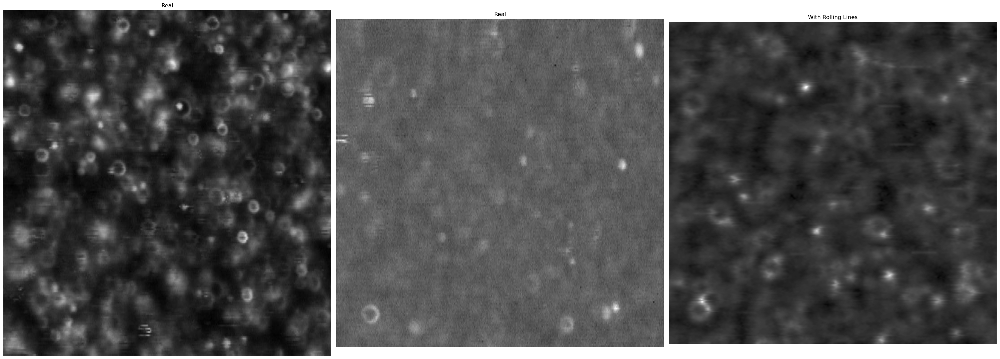

(640, 640)


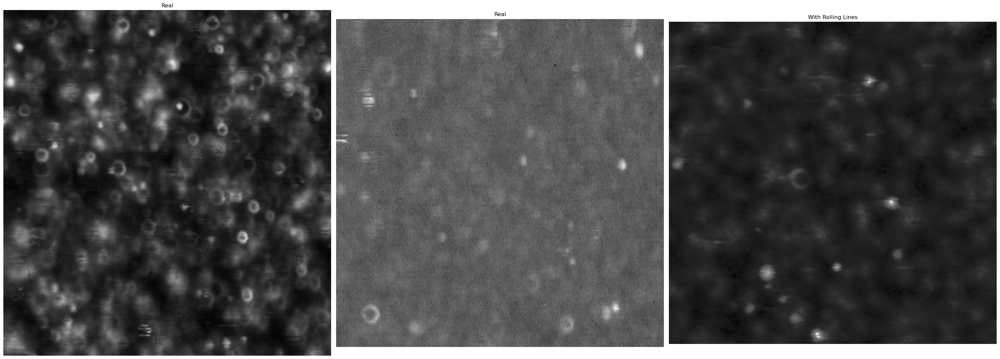

(640, 640)


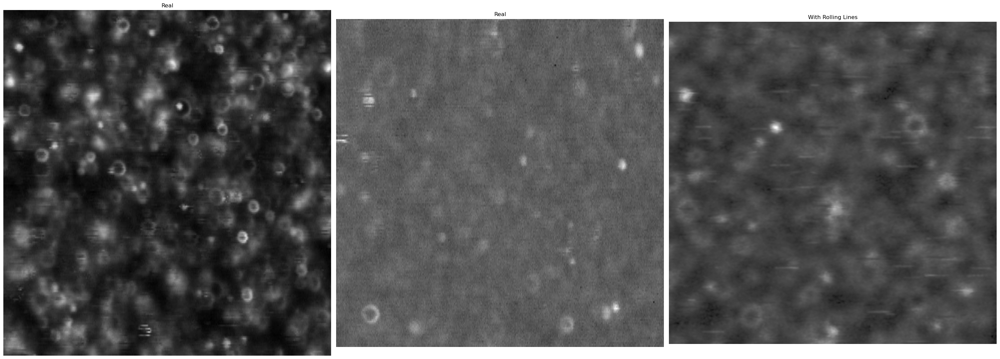

(640, 640)


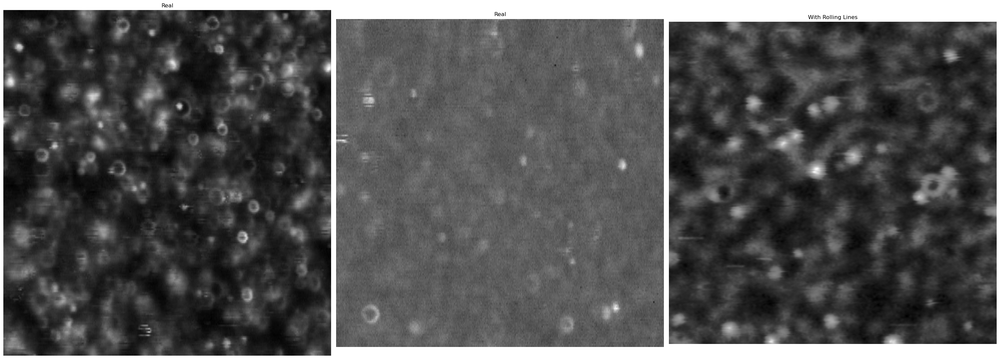

(640, 640)


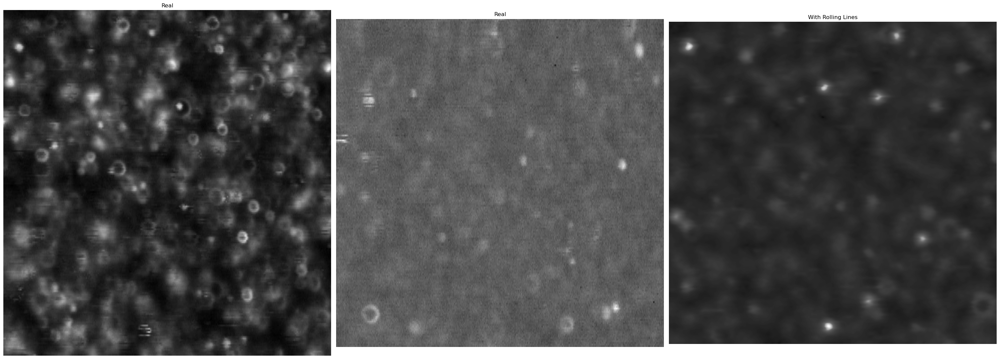

(640, 640)


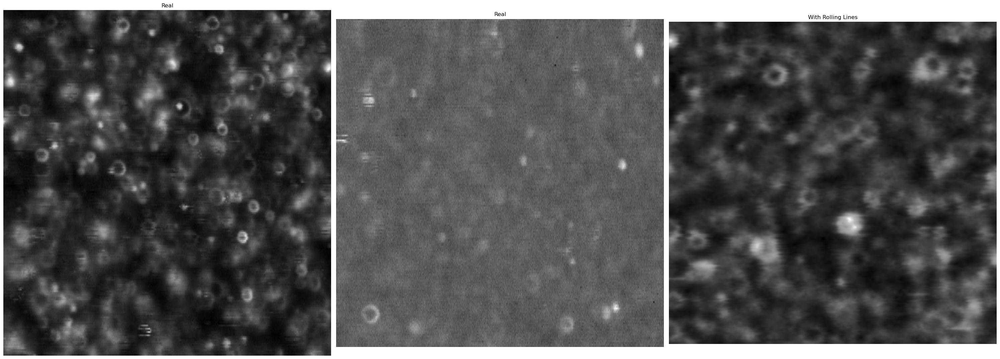

(640, 640)


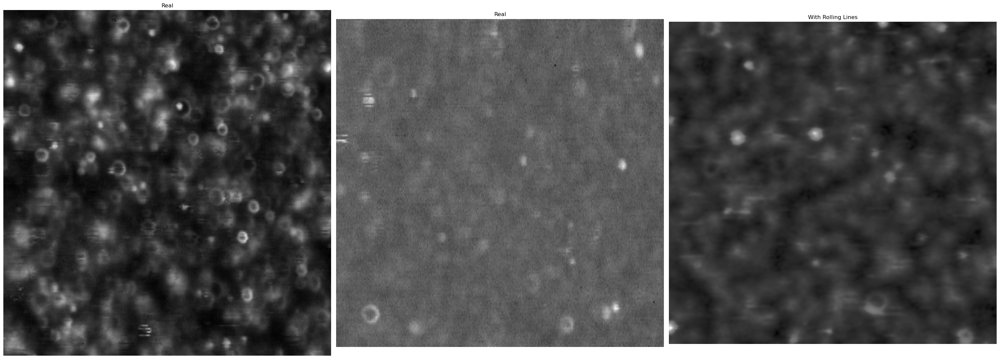

(640, 640)


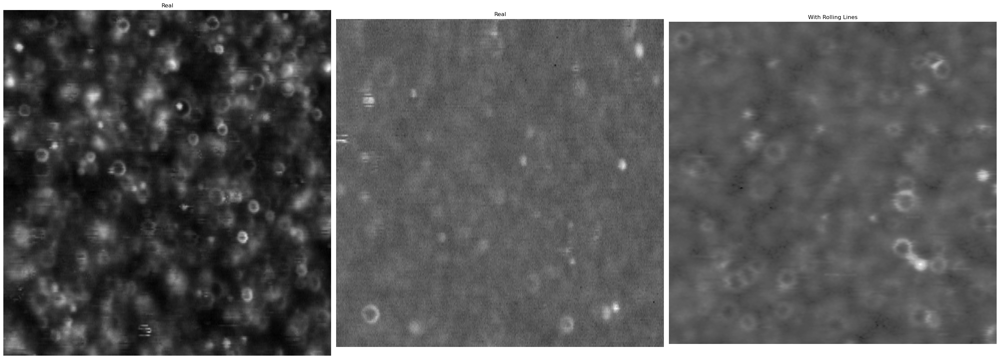

(640, 640)


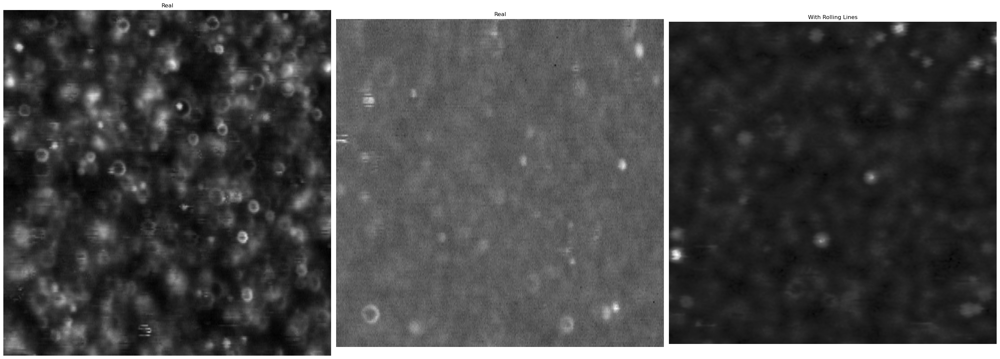

(640, 640)


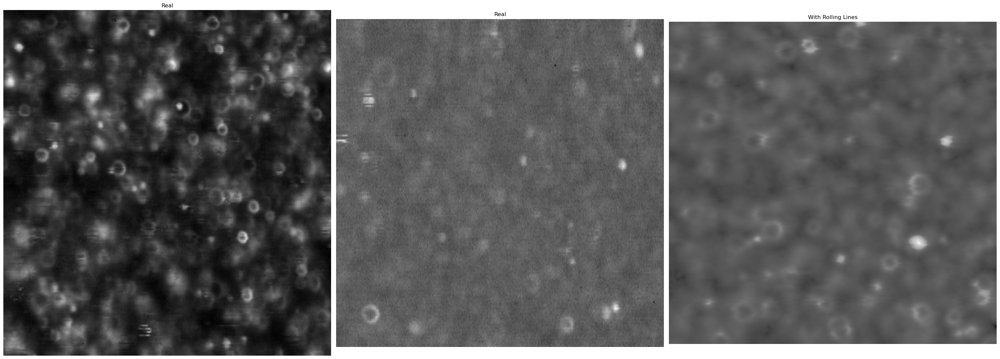

(640, 640)


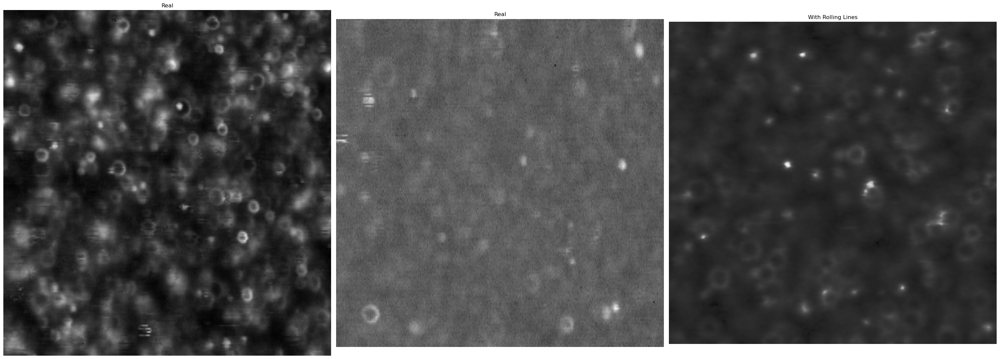

(640, 640)


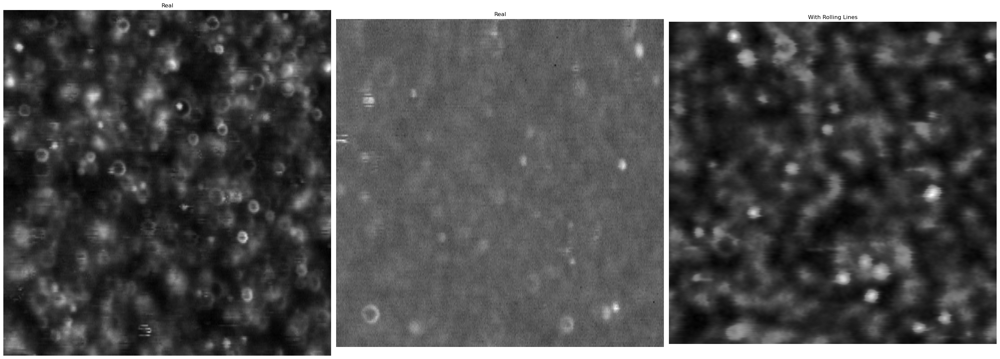

(640, 640)


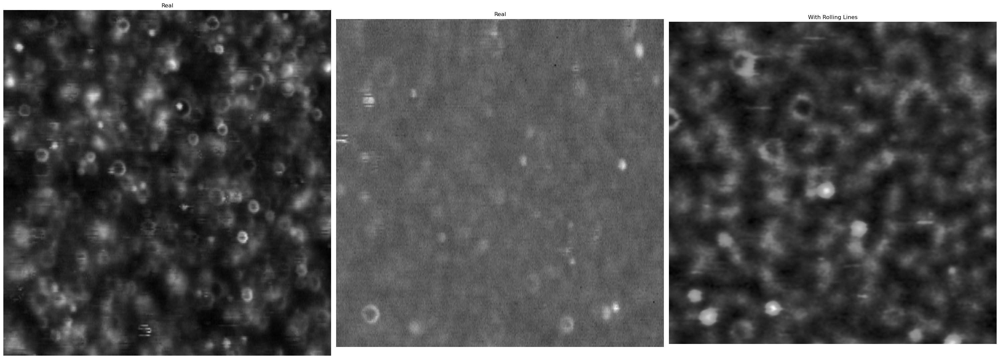

(640, 640)


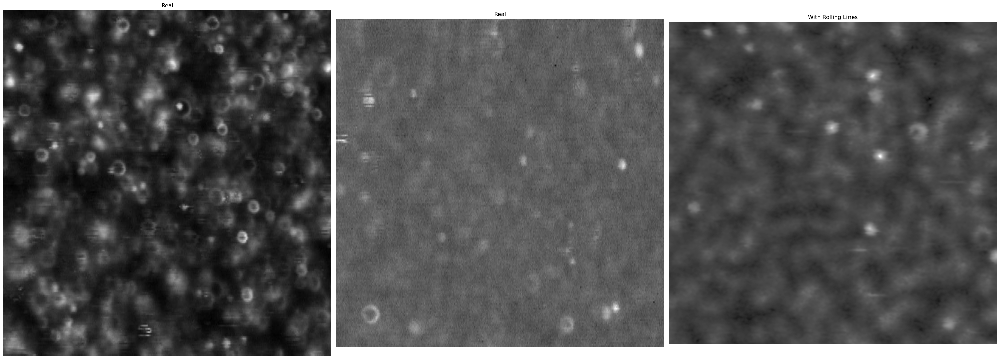

(640, 640)


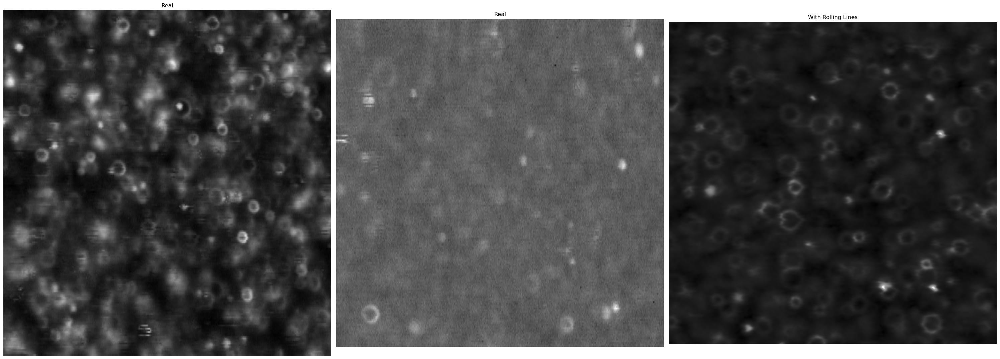

(640, 640)


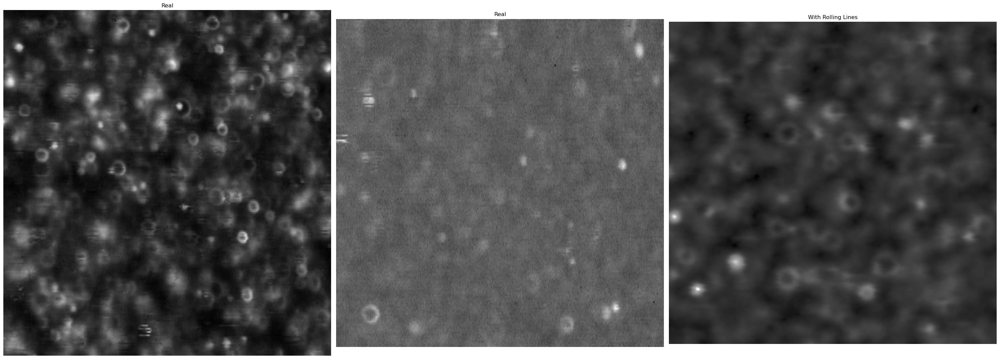

(640, 640)


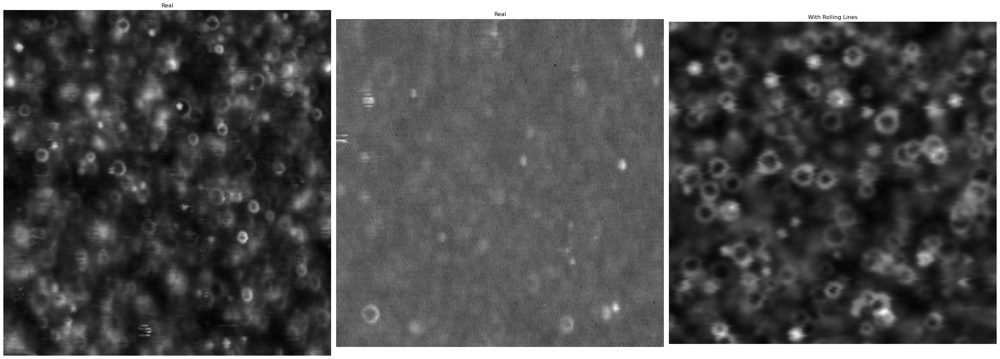

(640, 640)


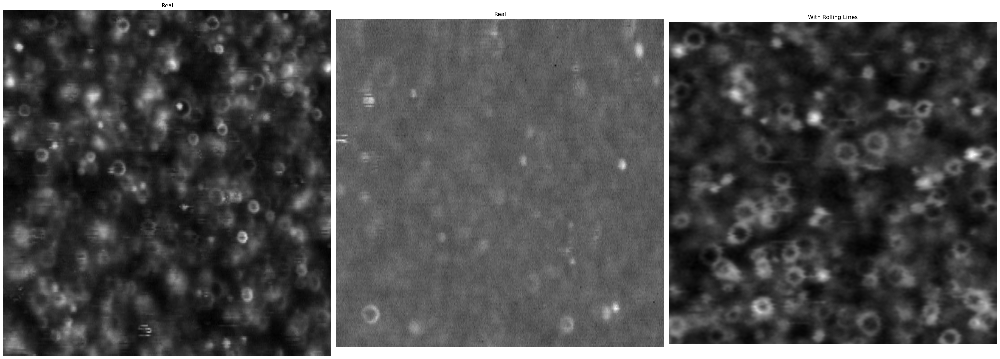

(640, 640)


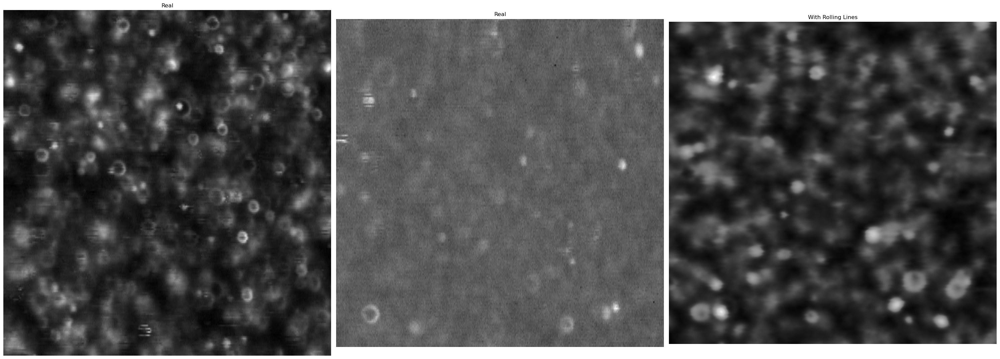

(640, 640)


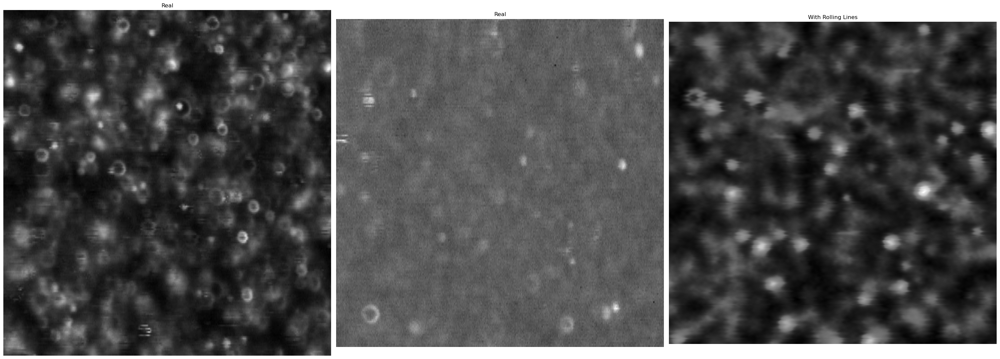

In [9]:
def add_rolling_lines(image, n_lines=10, roll_range=(1, 5)):
    """
    Add randomly positi oned horizontal lines, roll them by random amounts,
    and crop the image to remove roll-over artifacts.
    
    Args:
        image: Input image (numpy array)
        n_lines: Number of lines to add
        roll_range: Range for random roll amount (min, max)
        
    Returns:
        Modified image with rolled lines and cropped edges
    """
    # Make a copy of the input image
    result = image.copy()
    height, width = image.shape
    
    # Track the maximum roll amount used
    max_roll = 0
    
    for _ in range(n_lines):
        # Create a line at random y position
        y_pos = random.randint(0, height-1)
        
        # Get the line
        line = result[y_pos, :].copy()
        
        # Roll the line by random amount
        roll_amount = random.randint(*roll_range)
        max_roll = max(max_roll, roll_amount)
        rolled_line = np.roll(line, roll_amount)
        
        # Put the rolled line back
        result[y_pos, :] = rolled_line
    
    # Crop the image to remove roll-over artifacts
    if max_roll > 0:
        result = result[max_roll:-max_roll, max_roll:-max_roll]
    
    return result


def match_histograms(generated_img, reference_img):
    """
    Match the histogram of the generated image to the reference image.
    
    Args:
        generated_img: The generated image with high contrast
        reference_img: A representative real image with desired contrast
        
    Returns:
        Adjusted generated image with contrast matching the reference
    """
    # Convert to grayscale if needed for histogram matching
    if len(generated_img.shape) == 3 and len(reference_img.shape) == 3:
        # Match each channel separately for color images
        matched = np.zeros_like(generated_img)
        for i in range(3):  # RGB channels
            matched[:,:,i] = exposure.match_histograms(
                generated_img[:,:,i], 
                reference_img[:,:,i]
            )
        return matched
    else:
        # For grayscale
        return exposure.match_histograms(generated_img, reference_img)
    
    
for i in range(20):
    # Generate synthetic image with rolled lines
    n = 650
    # Generate synthetic image with bounding boxes
    synthetic, donut_boxes = generate_synthetic_data(n, num_circles_range=(10, 60), num_donuts_range_max=(50, 300),
                                                    num_donuts_range_min=(10,25),
                                                    radius_range_circle=(5, 15), radius_range_donuts=(4,20), 
                                                    thickness_range=(2, 4))
    synthetic_with_line_noise = add_line_noise(synthetic, num_lines_range=(50, 200), segment_length_range=(5, 50), noise_range=(-0.7, 0.6))
    synthetic_with_noise = add_gaussian_noise(synthetic_with_line_noise, mean=0, std=0.1)
    synthetic_with_noise = cv2.GaussianBlur(synthetic_with_noise, (0, 0), random.uniform(1,3))
    synthetic_with_roll_with_noise = add_rolling_lines(synthetic_with_noise, n_lines=400, roll_range=(1, 5))
    image = cv2.GaussianBlur(synthetic_with_roll_with_noise, (0, 0), random.uniform(1,2))
    image = add_gaussian_noise(image, mean=0, std=0.001)

    
    contrast_like = random.choice(list(trap_images.keys()))
    image = match_histograms(image, trap_images[contrast_like][:,:,0])

    # Visualize results
    fig, axs = plt.subplots(1, 3, figsize=(30, 20))
    print(synthetic_with_roll_with_noise.shape)
   # ax1.imshow(synthetic, cmap='gray')
   # ax1.set_title('Original Synthetic')
   # ax1.axis('off')
    
    axs[0].imshow(trap_images['1'], cmap='gray')
    axs[0].set_title('Real')
    axs[0].axis('off')

    axs[1].imshow(trap_images['6'], cmap='gray')
    axs[1].set_title('Real')
    axs[1].axis('off')

    axs[2].imshow(image[10:630, 10:640], cmap='gray')
    axs[2].set_title('With Rolling Lines')
    axs[2].axis('off')


    plt.tight_layout()
    plt.show()

    # apply gaussian filter to whole image
    #synthetic_with_lines = cv2.GaussianBlur(synthetic_with_lines, (0, 0), random.uniform(1,3))

#    plt.figure(figsize=(10, 10))
#    plt.imshow(synthetic_with_roll_with_noise, cmap='gray')
#    plt.axis('off')
#    plt.show()


In [99]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
import os
import json
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from tqdm import tqdm


# Generate dataset and save as numpy arrays
def generate_dataset(num_images=5000, image_size=512):
    # Split indices for train/val
    indices = list(range(num_images))
    random.shuffle(indices)
    train_size = int(0.8 * num_images)
    train_indices = set(indices[:train_size])
    val_indices = set(indices[train_size:])
    
    # Initialize arrays to store images
    train_images = np.zeros((train_size, image_size, image_size), dtype=np.float32)
    val_images = np.zeros((num_images - train_size, image_size, image_size), dtype=np.float32)
    
    # Dictionaries to store annotations
    train_annotations = []
    val_annotations = []
    
    train_idx = 0
    val_idx = 0
    
    print(f"Generating {num_images} synthetic images...")
    for i in tqdm(range(num_images)):
        # Generate synthetic image with rolled lines
        n = image_size + 10
        # Generate synthetic image with bounding boxes
        synthetic, donut_boxes = generate_synthetic_data(n, num_circles_range=(10, 60), num_donuts_range_max=(50, 300),
                                                        num_donuts_range_min=(10,25),
                                                        radius_range_circle=(5, 15), radius_range_donuts=(4,20), 
                                                        thickness_range=(2, 4))
        synthetic_with_line_noise = add_line_noise(synthetic, num_lines_range=(50, 200), segment_length_range=(5, 50), noise_range=(-0.7, 0.6))
        synthetic_with_noise = add_gaussian_noise(synthetic_with_line_noise, mean=0, std=0.1)
        synthetic_with_noise = cv2.GaussianBlur(synthetic_with_noise, (0, 0), random.uniform(1,3))
        synthetic_with_roll_with_noise = add_rolling_lines(synthetic_with_noise, n_lines=400, roll_range=(1, 5))
        image = cv2.GaussianBlur(synthetic_with_roll_with_noise, (0, 0), random.uniform(1,2))

        image = add_gaussian_noise(image, mean=0, std=0.001)

        
        contrast_like = random.choice(list(trap_images.keys()))
        image = match_histograms(image, trap_images[contrast_like][:,:,0])

        # Add image and annotations to appropriate arrays
        if i in train_indices:
          #  print(image.shape)
            train_images[train_idx] = image
            train_annotations.append({
                'image_id': train_idx,
                'boxes': donut_boxes
            })
            train_idx += 1
        else:
            val_images[val_idx] = image
            val_annotations.append({
                'image_id': val_idx,
                'boxes': donut_boxes
            })
            val_idx += 1
    
    # check to see directories exist, if not make them

    # Check if directories exist, if not create them
    os.makedirs('synthetic_data/numpy_arrays', exist_ok=True)
    os.makedirs('synthetic_data/annotations', exist_ok=True)

    # Save arrays
    np.save('synthetic_data/numpy_arrays/train_images.npy', train_images)
    np.save('synthetic_data/numpy_arrays/val_images.npy', val_images)
    
    # Save annotations
    with open('synthetic_data/annotations/train_annotations.json', 'w') as f:
        json.dump(train_annotations, f)
    with open('synthetic_data/annotations/val_annotations.json', 'w') as f:
        json.dump(val_annotations, f)
    
    print(f"Generated {train_size} training images and {num_images - train_size} validation images")
    print(f"Train array shape: {train_images.shape}")
    print(f"Val array shape: {val_images.shape}")
    return train_size, num_images - train_size

# Generate the dataset
train_size, val_size = generate_dataset(num_images=5000, image_size=640)


Generating 5000 synthetic images...


100%|██████████| 5000/5000 [18:07:34<00:00, 13.05s/it]   


Generated 4000 training images and 1000 validation images
Train array shape: (4000, 640, 640)
Val array shape: (1000, 640, 640)


In [ ]:
import os

# Check if directories exist, if not create them
os.makedirs('synthetic_data_3/numpy_arrays', exist_ok=True)
os.makedirs('synthetic_data_3/annotations', exist_ok=True)

print("Directories created successfully!")

In [11]:
import numpy as np
import json
import random
import os

In [14]:
# Load validation data and annotations
val_images = np.load('synthetic_data_small/numpy_arrays/val_images.npy')
with open('synthetic_data_small/annotations/val_annotations.json', 'r') as f:
    val_annotations = json.load(f)

# Calculate split sizes
total_size = len(val_images)
new_train_size = int(0.9 * total_size)

# Generate random indices for splitting
indices = list(range(total_size))
random.shuffle(indices)
new_train_indices = indices[:new_train_size]
new_val_indices = indices[new_train_size:]

# Split images
new_train_images = val_images[new_train_indices]
new_val_images = val_images[new_val_indices]

# Split annotations
new_train_annotations = [val_annotations[i] for i in new_train_indices]
new_val_annotations = [val_annotations[i] for i in new_val_indices]

# Create directories if they don't exist
os.makedirs('synthetic_data_small/numpy_arrays/split', exist_ok=True)
os.makedirs('synthetic_data_small/annotations/split', exist_ok=True)

# Save new splits
np.save('synthetic_data_small/numpy_arrays/split/new_train_images.npy', new_train_images)
np.save('synthetic_data_small/numpy_arrays/split/new_val_images.npy', new_val_images)

with open('synthetic_data_small/annotations/split/new_train_annotations.json', 'w') as f:
    json.dump(new_train_annotations, f)
with open('synthetic_data_small/annotations/split/new_val_annotations.json', 'w') as f:
    json.dump(new_val_annotations, f)

print(f"New training set size: {len(new_train_images)}")
print(f"New validation set size: {len(new_val_images)}")

New training set size: 900
New validation set size: 100


In [1]:
train_size

NameError: name 'train_size' is not defined

In [ ]:

# Custom Dataset class for numpy array
class DonutDataset(Dataset):
    def __init__(self, images_file, annotation_file, transform=None):
        self.images = np.load(images_file)
        
        # Load annotations
        with open(annotation_file, 'r') as f:
            self.annotations = json.load(f)
            
        self.transform = transform
        
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        # Get image
        image = self.images[idx]
        
        # Get annotations for this image
        anno = self.annotations[idx]
        boxes = anno['boxes']
        
        # Convert boxes to tensor format [x1, y1, x2, y2]
        box_tensors = []
        for box in boxes:
            box_tensors.append([box['x1'], box['y1'], box['x2'], box['y2']])
            
        # Convert to tensor
        image = torch.tensor(image).unsqueeze(0)  # Add channel dimension
        
        if len(box_tensors) > 0:
            targets = torch.tensor(box_tensors, dtype=torch.float)
        else:
            # Handle images with no boxes
            targets = torch.zeros((0, 4), dtype=torch.float)
            
        # Apply transformations if specified
        if self.transform:
            image = self.transform(image)
            
        return image, targets, idx

# DonutDetector model (same as before)
class DonutDetector(nn.Module):
    def __init__(self, max_detections=50):
        super(DonutDetector, self).__init__()
        self.max_detections = max_detections
        
        # Feature extraction backbone
        self.backbone = nn.Sequential(
            nn.Conv2d(1, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),
            
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),
            
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),
            
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),
            
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2)
        )
        
        # Detection head
        self.box_predictor = nn.Sequential(
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 4 * self.max_detections, kernel_size=1)  # 4 values per box (x1,y1,x2,y2)
        )
        
        # Classification head (confidence score)
        self.conf_predictor = nn.Sequential(
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, self.max_detections, kernel_size=1)  # 1 confidence score per box
        )

    def forward(self, x):
        batch_size = x.shape[0]
        features = self.backbone(x)
        
        # Get box predictions
        box_preds = self.box_predictor(features)
        box_preds = box_preds.view(batch_size, self.max_detections, 4)
        
        # Get confidence scores
        conf_preds = self.conf_predictor(features)
        conf_preds = conf_preds.view(batch_size, self.max_detections)
        conf_preds = torch.sigmoid(conf_preds)  # Convert to 0-1 probability
        
        return box_preds, conf_preds

# Training function
def train_model(model, train_loader, val_loader, num_epochs=10):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")
    
    model = model.to(device)
    
    # Loss functions for box regression and confidence
    criterion_box = nn.SmoothL1Loss()
    criterion_conf = nn.BCELoss()
    
    # Optimizer
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    
    best_val_loss = float('inf')
    
    for epoch in range(num_epochs):
        # Training phase
        model.train()
        train_loss = 0.0
        
        for images, targets, _ in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} Training"):
            images = images.to(device)
            
            # Zero the gradients
            optimizer.zero_grad()
            
            # Forward pass
            box_preds, conf_preds = model(images)
            
            batch_loss = 0
            
            # Process each image in batch
            for i in range(images.shape[0]):
                gt_boxes = targets[i].to(device)
                
                # Skip if no ground truth boxes
                if gt_boxes.shape[0] == 0:
                    continue
                
                num_gt = gt_boxes.shape[0]
                
                # Create ground truth confidence
                gt_conf = torch.zeros(model.max_detections, device=device)
                gt_conf[:num_gt] = 1
                
                # Pad ground truth boxes
                padded_gt_boxes = torch.zeros((model.max_detections, 4), device=device)
                padded_gt_boxes[:num_gt] = gt_boxes
                
                # Calculate losses
                box_loss = criterion_box(box_preds[i], padded_gt_boxes)
                conf_loss = criterion_conf(conf_preds[i], gt_conf)
                
                img_loss = box_loss + conf_loss
                batch_loss += img_loss
            
            batch_loss = batch_loss / images.shape[0]
            batch_loss.backward()
            optimizer.step()
            
            train_loss += batch_loss.item()
        
        avg_train_loss = train_loss / len(train_loader)
        
        # Validation phase
        model.eval()
        val_loss = 0.0
        
        with torch.no_grad():
            for images, targets, _ in tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} Validation"):
                images = images.to(device)
                
                # Forward pass
                box_preds, conf_preds = model(images)
                
                batch_loss = 0
                
                for i in range(images.shape[0]):
                    gt_boxes = targets[i].to(device)
                    
                    # Skip if no ground truth boxes
                    if gt_boxes.shape[0] == 0:
                        continue
                    
                    num_gt = gt_boxes.shape[0]
                    
                    # Create ground truth confidence
                    gt_conf = torch.zeros(model.max_detections, device=device)
                    gt_conf[:num_gt] = 1
                    
                    # Pad ground truth boxes
                    padded_gt_boxes = torch.zeros((model.max_detections, 4), device=device)
                    padded_gt_boxes[:num_gt] = gt_boxes
                    
                    # Calculate losses
                    box_loss = criterion_box(box_preds[i], padded_gt_boxes)
                    conf_loss = criterion_conf(conf_preds[i], gt_conf)
                    
                    img_loss = box_loss + conf_loss
                    batch_loss += img_loss
                
                batch_loss = batch_loss / images.shape[0]
                val_loss += batch_loss.item()
        
        avg_val_loss = val_loss / len(val_loader)
        
        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}")
        
        # Save best model
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            torch.save(model.state_dict(), "donut_detector_best.pth")
            print("Saved best model checkpoint")
    
    return model

# Evaluation function
def evaluate_model(model, val_loader, num_samples=5):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = model.to(device)
    model.eval()
    
    # Get validation images
    val_images = np.load('synthetic_data/numpy_arrays/val_images.npy')
    
    with open('synthetic_data/annotations/val_annotations.json', 'r') as f:
        val_annotations = json.load(f)
    
    # Get a few samples
    dataiter = iter(val_loader)
    images, targets, indices = next(dataiter)
    
    with torch.no_grad():
        images = images.to(device)
        box_preds, conf_preds = model(images)
        
        # Convert to CPU for visualization
        images = images.cpu()
        box_preds = box_preds.cpu()
        conf_preds = conf_preds.cpu()
        
        # Visualize results
        for i in range(min(num_samples, images.shape[0])):
            img = images[i, 0].numpy()  # Remove channel dimension
            gt_boxes = targets[i].numpy()
            img_idx = indices[i].item()
            
            # Get predicted boxes (confidence threshold = 0.5)
            conf_threshold = 0.5
            pred_boxes = box_preds[i][conf_preds[i] > conf_threshold].numpy()
            
            # Visualize
            plt.figure(figsize=(10, 10))
            plt.imshow(img, cmap='gray')
            
            # Draw ground truth boxes (green)
            for box in gt_boxes:
                x1, y1, x2, y2 = box
                width = x2 - x1
                height = y2 - y1
                rect = plt.Rectangle((x1, y1), width, height, 
                                    fill=False, edgecolor='green', linewidth=2, label='Ground Truth')
                plt.gca().add_patch(rect)
            
            # Draw predicted boxes (red)
            for box in pred_boxes:
                x1, y1, x2, y2 = box
                width = x2 - x1
                height = y2 - y1
                rect = plt.Rectangle((x1, y1), width, height, 
                                    fill=False, edgecolor='red', linewidth=2, label='Prediction')
                plt.gca().add_patch(rect)
            
            # Remove duplicate labels
            handles, labels = plt.gca().get_legend_handles_labels()
            by_label = dict(zip(labels, handles))
            plt.legend(by_label.values(), by_label.keys())
            
            plt.title(f"Evaluation: Image {img_idx}")
            plt.axis('off')
            plt.tight_layout()
            plt.savefig(f"eval_{i}.png")
            plt.show()

# Main function
def main():
    # Create datasets
    train_dataset = DonutDataset(
        images_file='synthetic_data/numpy_arrays/train_images.npy',
        annotation_file='synthetic_data/annotations/train_annotations.json'
    )
    
    val_dataset = DonutDataset(
        images_file='synthetic_data/numpy_arrays/val_images.npy',
        annotation_file='synthetic_data/annotations/val_annotations.json'
    )
    
    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
    val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False, num_workers=4)
    
    # Initialize model
    model = DonutDetector(max_detections=50)  # Assume max 50 donuts per image
    
    # Train model
    model = train_model(model, train_loader, val_loader, num_epochs=15)
    
    # Save final model
    torch.save(model.state_dict(), "donut_detector_final.pth")
    
    # Test on a few validation images
    evaluate_model(model, val_loader, num_samples=5)

if __name__ == "__main__":
    main()

In [2]:
def otsu_threshold_n(img, n=4):
    # Compute Otsu's threshold on img and create a binary mask
    thresholds = threshold_multiotsu(img, classes=n)
    binary_otsu_upper = img > thresholds[n-2]
    binary_otsu_lower = img < thresholds[0]
    binary_otsu = binary_otsu_upper + binary_otsu_lower
    return binary_otsu, binary_otsu_upper, binary_otsu_lower

(800, 800)


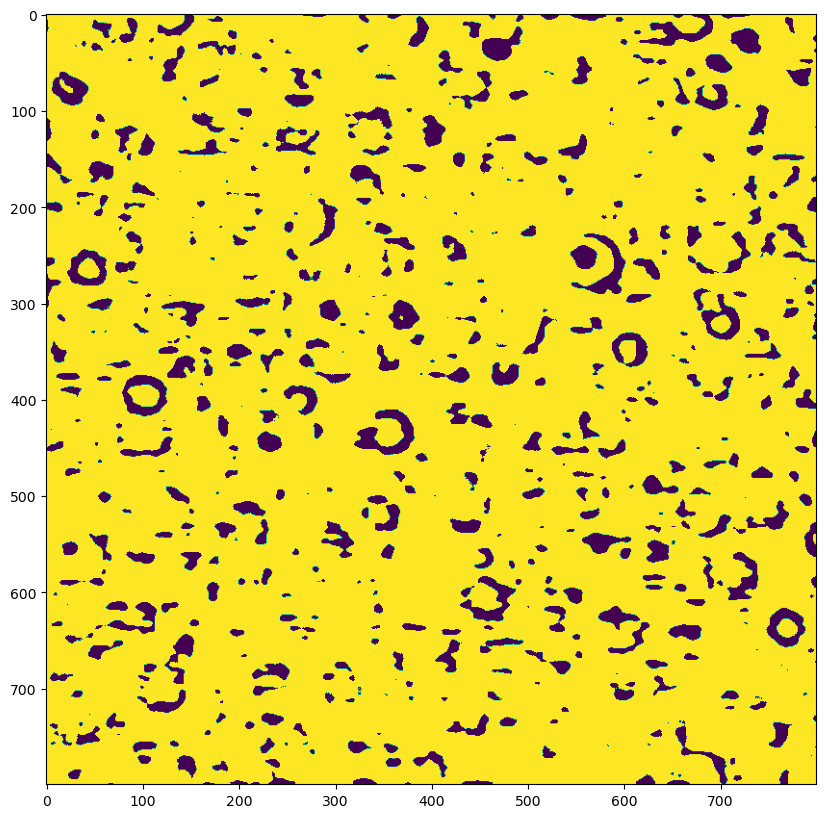

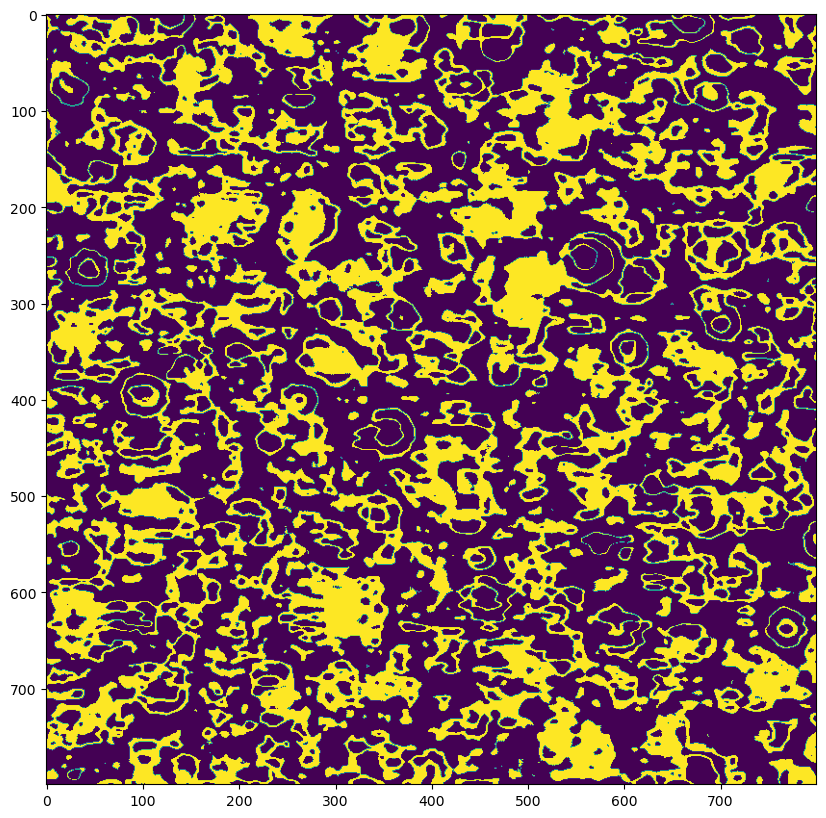

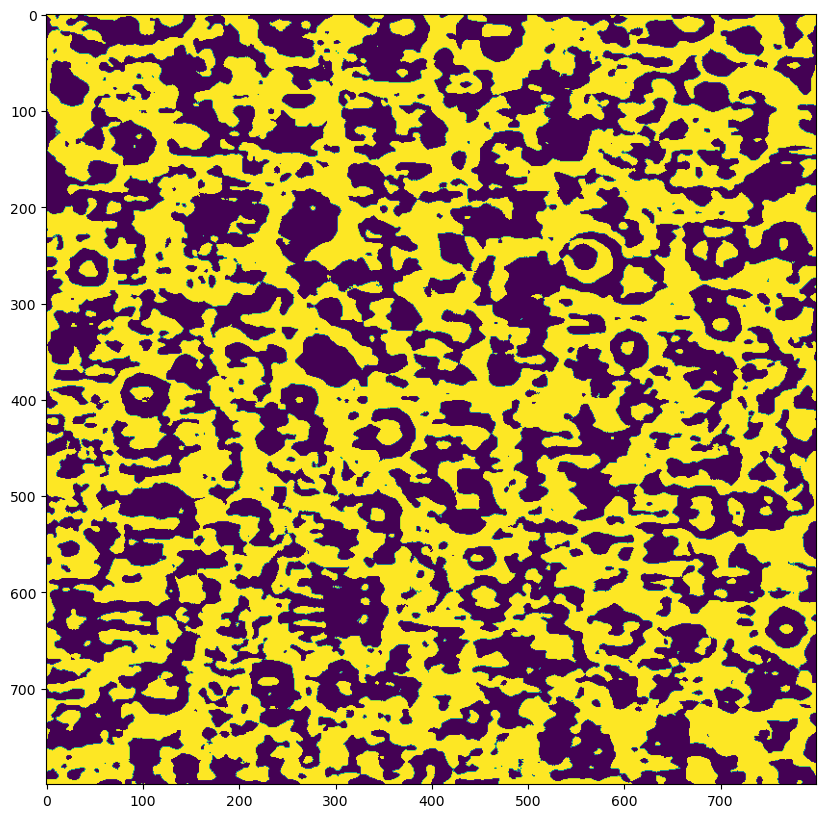

In [27]:
totsu = otsu_threshold_n(bandpassed, 3)
print(totsu[0].shape)
figsize_=(10,10)
plt.figure(figsize=figsize_)
plt.imshow( totsu[0])
plt.show()
plt.figure(figsize=figsize_)
plt.imshow(totsu[1])
plt.show()
plt.figure(figsize=figsize_)
plt.imshow(totsu[2])
plt.show()

In [39]:
def find_rings(image, n):
    
    # Compute x and y derivatives using numpy's gradient.
    # Note: axis 1 corresponds to x (columns) and axis 0 corresponds to y (rows)
    dy, dx = np.gradient(image)
    # Compute diagonal derivatives:
    # Main diagonal derivative (direction (1,1)) approximation:
    diag_main = (np.roll(image, shift=(-1, -1), axis=(0, 1)) -
                np.roll(image, shift=(1, 1), axis=(0, 1))) / (2 * np.sqrt(2))

    # Anti-diagonal derivative (direction (1,-1)) approximation:
    diag_anti = (np.roll(image, shift=(-1, 1), axis=(0, 1)) -
                np.roll(image, shift=(1, -1), axis=(0, 1))) / (2 * np.sqrt(2))

    dx_norm = min_max_normalize(dx)
    dy_norm = min_max_normalize(dy)
    diag_main_norm = min_max_normalize(diag_main)
    diag_anti_norm = min_max_normalize(diag_anti)

    '''
    dx_grad_p = dx_norm > upper_threshold
    dx_grad_n = dx_norm < lower_threshold
    dx_grad_total = dx_grad_p + dx_grad_n

    dy_grad_p = dy_norm > upper_threshold
    dy_grad_n = dy_norm < lower_threshold
    dy_grad_total = dy_grad_p + dy_grad_n

    diag_anti_grad_p = diag_anti_norm > upper_threshold
    diag_anti_grad_n = diag_anti_norm < lower_threshold
    diag_anti_grad_total = diag_anti_grad_p + diag_anti_grad_n

    diag_main_grad_p = diag_main_norm > upper_threshold
    diag_main_grad_n = diag_main_norm < lower_threshold
    diag_main_grad_total = diag_main_grad_p + diag_main_grad_n
    '''
    
    dx_grad_total = otsu_threshold_n(dx_norm, n)[0]
    dy_grad_total = otsu_threshold_n(dy_norm, n)[0]
   # diag_anti_grad_total = otsu_threshold_n(diag_anti_norm, n)
   # diag_main_grad_total = otsu_threshold_n(diag_main_norm, n)

    #print all shapes
    rings1 = dy_grad_total + dx_grad_total #+ diag_anti_grad_total + diag_main_grad_total
    
    rings2 = dx_norm + dy_norm + diag_main_norm + diag_anti_norm
    rings2 = min_max_normalize(rings2)
    #plt.imshow(rings1, cmap='gray')
    #plt.axis("off")
    #plt.show()
    
    return rings1, rings2


(15, 15, 100, 100)


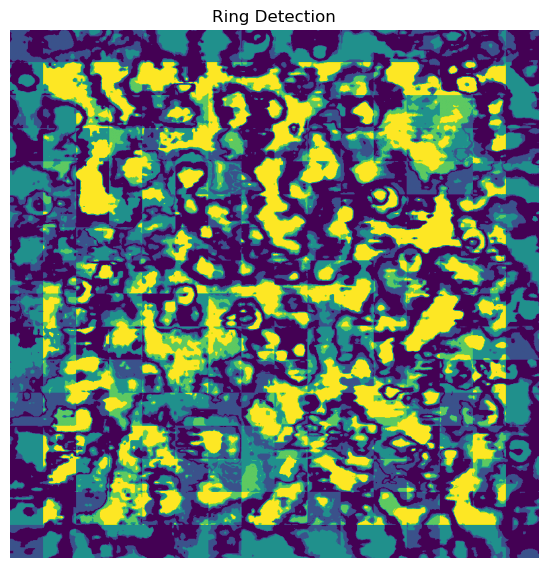

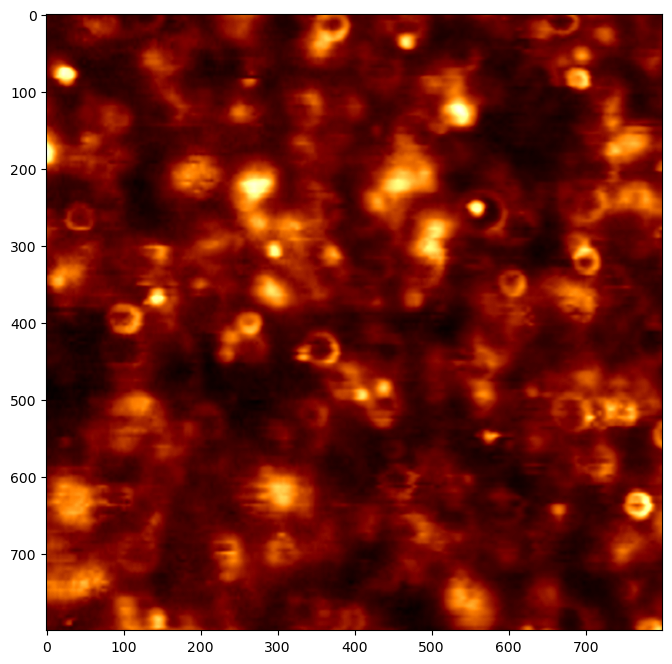

In [ ]:
step_size = 50
patch_res = 100
patches = pat.patchify(img_gray, (100, 100), step=50)
# The shape of patches is (n_rows, n_cols, 100, 100)
print(patches.shape)
# Apply min_max_normalize to each 100x100 patch
patches_normalized = np.empty_like(patches, dtype=float)
patches_rings1 = np.empty_like(patches, dtype=float)
for i in range(patches.shape[0]):
    for j in range(patches.shape[1]):
        patches_normalized[i, j] = min_max_normalize(patches[i, j])
        patches_normalized[i, j] = enhance_local_contrast(patches_normalized[i, j])
        patches_rings1[i,j] = otsu_threshold_n(patches_normalized[i, j], 4)[0]

# stitch them back together
# make a sin window mask
sin = np.sin(np.linspace(0, np.pi, 100))
mask = sin[:, None] * sin[None, :]
mask = mask / mask.max()

prediction = np.zeros((1, 800, 800))
for i in range(15):
    for j in range(15):
        prediction[:,i*step_size:(i*step_size)+patch_res, j*step_size:(j*step_size)+patch_res] = prediction[:,i*step_size:(i*step_size)+patch_res, j*step_size:(j*step_size)+patch_res] + patches_rings1[i,j]     
    
reconstructed_img = prediction[0]

plt.figure(figsize=(15, 8))
plt.subplot(121)
plt.imshow(reconstructed_img, cmap='viridis')
plt.title('Ring Detection')
plt.axis('off')
plt.show()
plt.figure(figsize=(15, 8))
plt.imshow(img_gray, cmap='afmhot')
plt.show()


In [181]:
def make_kernel_radius_n(n):
    kernel_size = n
    kernel = np.zeros((kernel_size, kernel_size), dtype=np.float32)
    center = kernel_size // 2  

    outer_radius = n//2
    inner_radius = outer_radius - 6  # ring thickness of 4

    y, x = np.ogrid[:kernel_size, :kernel_size]
    distance = np.sqrt((x - center)**2 + (y - center)**2)
    kernel[(distance >= inner_radius) & (distance <= outer_radius)] = 1.0

#    kernel[kernel==0] = -1
    return kernel

In [6]:
kernel_20 = make_kernel_radius_n(55)

In [7]:
def kernel_convolve(kernel, img, thresh=0.7):
    img = (img - np.min(img)) / (np.max(img) - np.min(img))
    convolved_img = cv2.filter2D(img.copy(), -1, kernel)
    #plt.figure(figsize=(10,10))
    #plt.imshow(convolved_img, cmap='afmhot')
    #plt.axis("off")
    #plt.show()
    #plt.figure(figsize=(10,10))
    convolved_img = (convolved_img - np.min(convolved_img)) / (np.max(convolved_img) - np.min(convolved_img))
    #plt.imshow(convolved_img>thresh, cmap='afmhot')
    #plt.axis("off")
    #plt.show()
    plt.figure(figsize=(10,10))
    plt.imshow(img+(convolved_img>thresh), cmap='afmhot')
    plt.show()


radius =  0


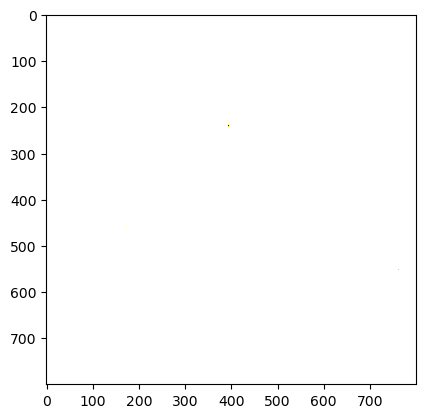

radius =  10


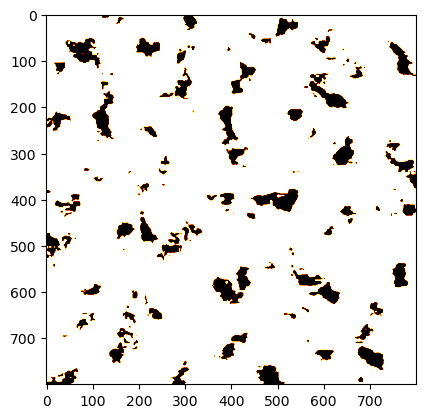

radius =  20


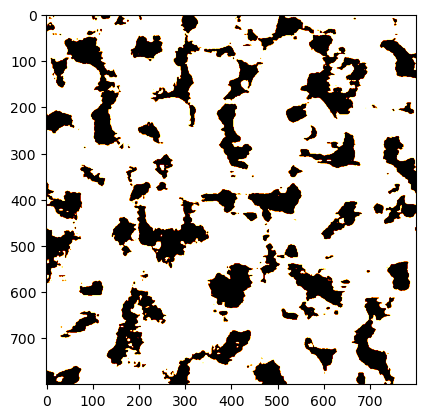

radius =  30


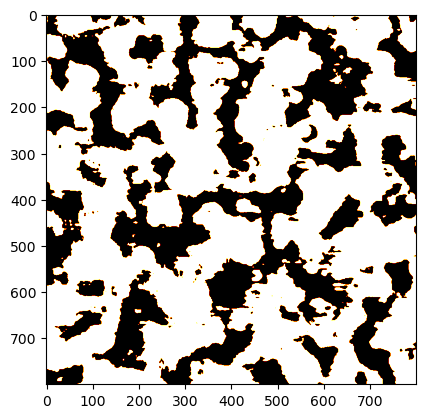

radius =  40


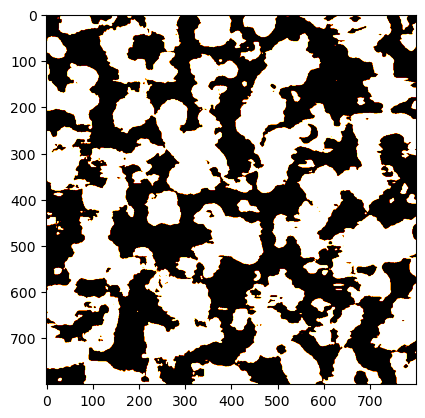

radius =  50


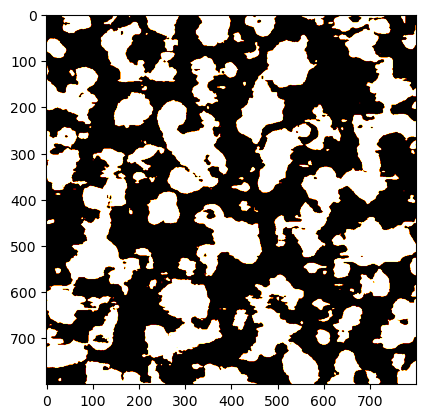

radius =  60


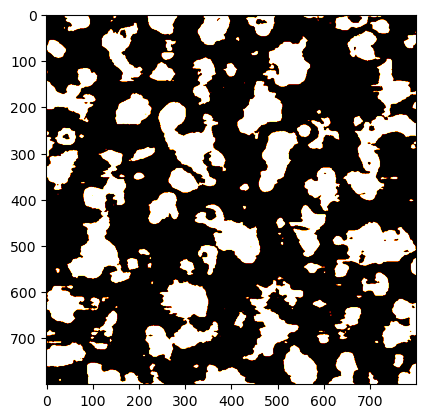

radius =  70


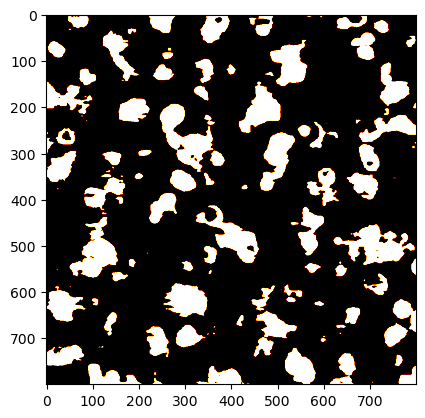

radius =  80


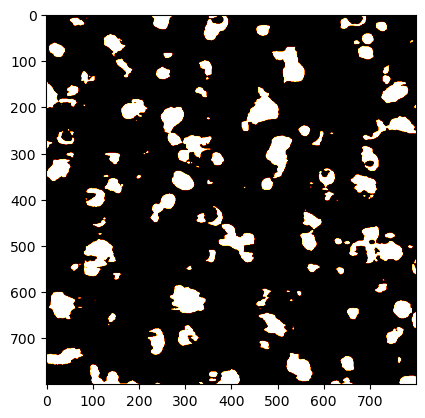

radius =  90


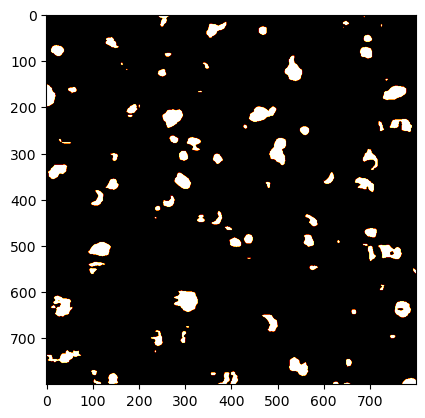

radius =  100


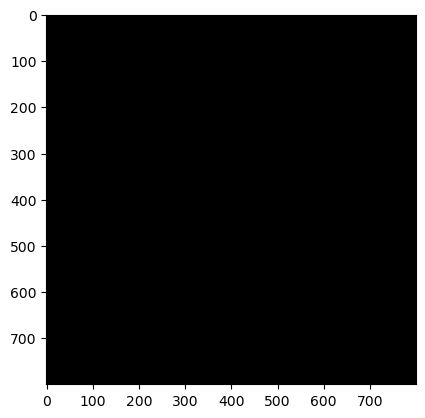

radius =  110


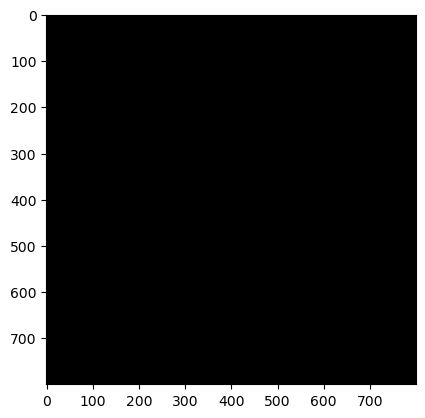

radius =  120


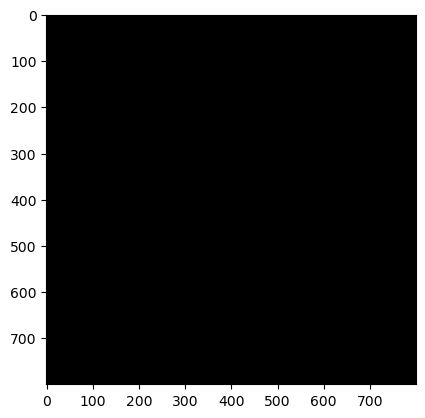

In [54]:
radii = [10*i for i in range(13)]
clahe_result = (clahe_result-np.min(clahe_result))/(np.max(clahe_result)-np.min(clahe_result))
for n in radii:
    print('radius = ', n)
   # kernel_convolve(make_kernel_radius_n(n), clahe_result, 0.95)
    plt.imshow((clahe_result>(n*0.01)),cmap='afmhot')
    plt.show()

In [8]:
def min_max_normalize(arr):
    arr_min = arr.min()
    arr_max = arr.max()
    return (arr - arr_min) / (arr_max - arr_min)

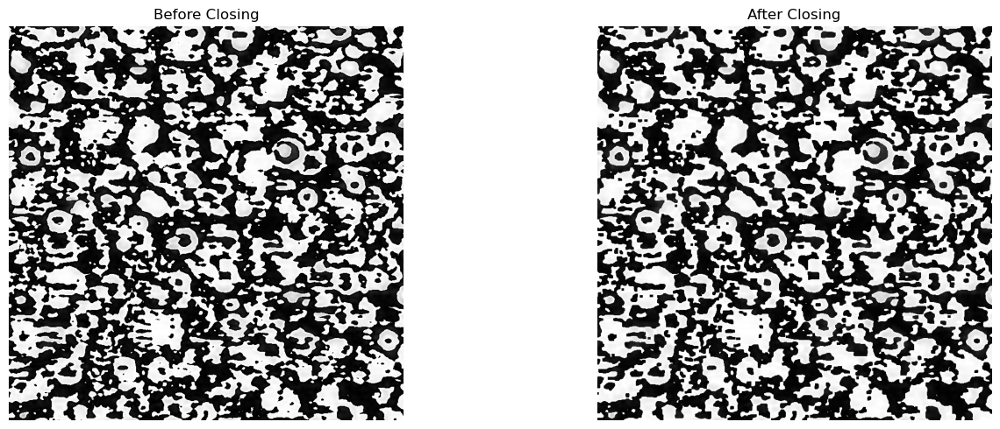

In [55]:
def morphological_closing(image, kernel_size=3):
    # Ensure image is binary/uint8
    if image.dtype != np.uint8:
        image = (image * 255).astype(np.uint8)
    
    # Create kernel
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    
    # Perform closing: dilation followed by erosion
    closing = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    
    return closing

# Apply to your image
closed_img = morphological_closing(bandpassed, kernel_size=5)


# Visualize results
plt.figure(figsize=(15, 5))
plt.subplot(121)
plt.imshow(bandpassed, cmap='gray')
plt.title('Before Closing')
plt.axis('off')

plt.subplot(122)
plt.imshow(closed_img, cmap='gray')
plt.title('After Closing')
plt.axis('off')

plt.tight_layout()
plt.show()

(8, 8, 100, 100)


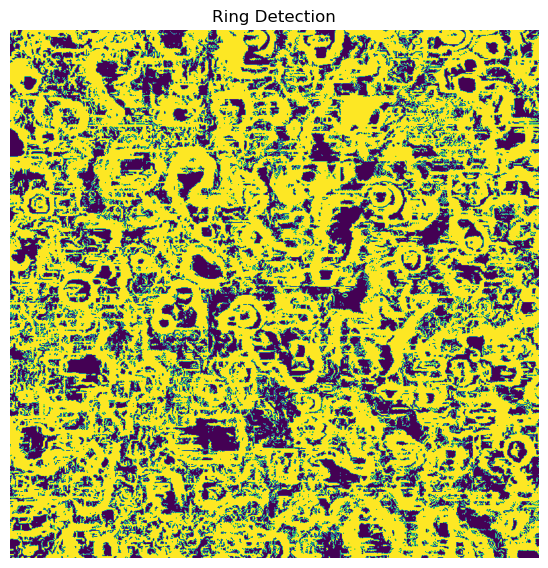

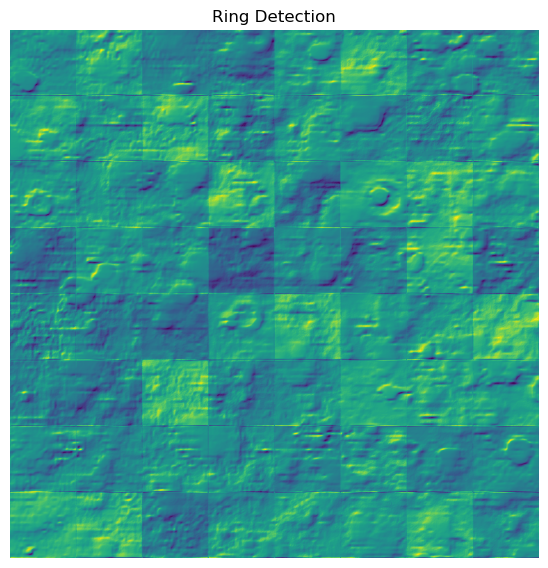

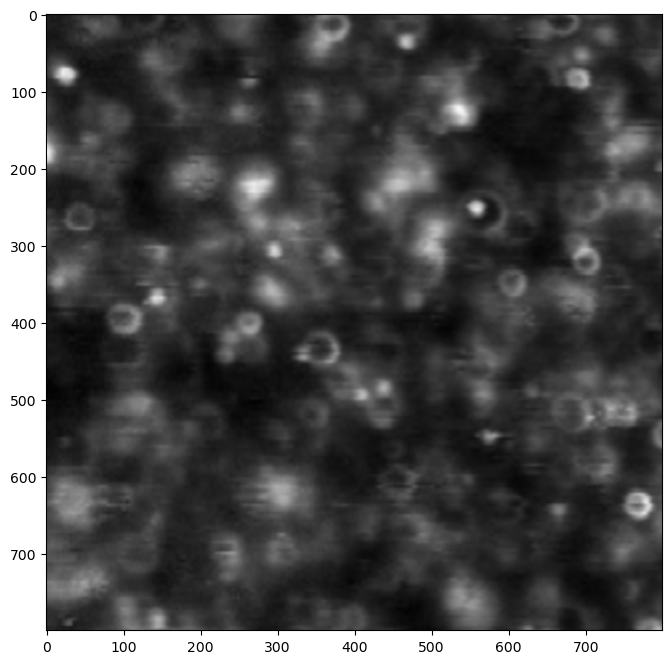

In [41]:
patches = pat.patchify(clahe_result, (100, 100), step=100)
# The shape of patches is (n_rows, n_cols, 100, 100)
print(patches.shape)
# Apply min_max_normalize to each 100x100 patch
patches_normalized = np.empty_like(patches, dtype=float)
patches_rings1 = np.empty_like(patches, dtype=float)
patches_rings2 = np.empty_like(patches, dtype=float)
for i in range(patches.shape[0]):
    for j in range(patches.shape[1]):
        patches_normalized[i, j] = min_max_normalize(patches[i, j])
        patches_rings1[i,j], patches_rings2[i,j] = find_rings(patches_normalized[i, j],3)

# stitch them back together

reconstructed_img = pat.unpatchify(patches_rings1, img_gray.shape)
reconstructed_img2 = pat.unpatchify(patches_rings2, img_gray.shape)

plt.figure(figsize=(15, 8))
plt.subplot(121)
plt.imshow(reconstructed_img, cmap='viridis')
plt.title('Ring Detection')
plt.axis('off')
plt.show()
plt.figure(figsize=(15, 8))
plt.subplot(121)
plt.imshow(reconstructed_img2, cmap='viridis')
plt.title('Ring Detection')
plt.axis('off')
plt.show()
plt.figure(figsize=(15, 8))
plt.imshow(img_gray, cmap='gray')
plt.show()


In [9]:
# Method 1: Adaptive Thresholding using OpenCV
def adaptive_threshold(img):
    # Convert to uint8 if needed
    if img.dtype != np.uint8:
        img = (img * 255).astype(np.uint8)
    
    return cv2.adaptiveThreshold(
        img,
        maxValue=255,
        adaptiveMethod=cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        thresholdType=cv2.THRESH_BINARY,
        blockSize=11,  # must be odd
        C=2
    )

# Method 2: CLAHE (Contrast Limited Adaptive Histogram Equalization)
def enhance_local_contrast(img):
    # Convert to uint8 if needed
    if img.dtype != np.uint8:
        img = (img * 255).astype(np.uint8)
    
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    return clahe.apply(img)

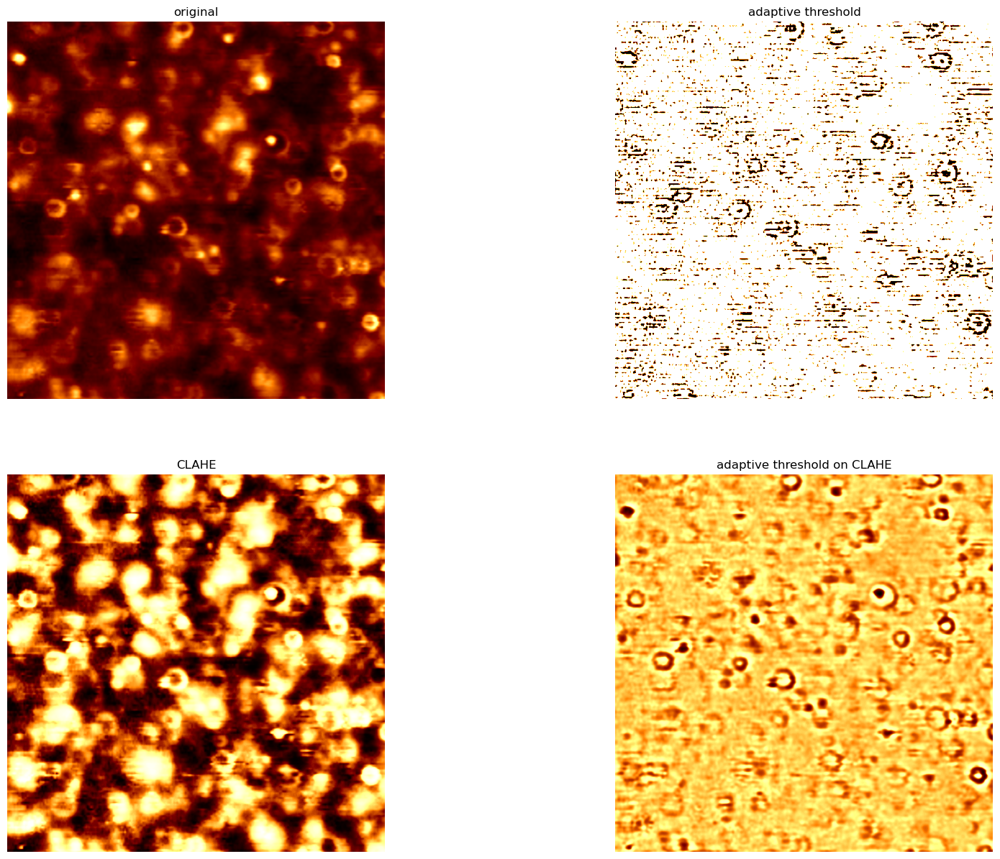

In [81]:
# Apply both methods and compare
adaptive_result = adaptive_threshold(img_gray)
clahe_result = enhance_local_contrast(img_gray)
clahe_result = enhance_local_contrast(clahe_result)
adaptive_clahe_result = adaptive_threshold(clahe_result)
clahe_bp_result = enhance_local_contrast(bandpassed)

# Visualize results


fig, ax = plt.subplots(2,2, figsize=(20,15))
ax[0,0].imshow(img_gray, cmap='afmhot')
ax[0,0].set_title('original')
ax[0,0].axis('off')
ax[0,1].imshow(adaptive_result, cmap='afmhot')
ax[0,1].set_title('adaptive threshold')
ax[0,1].axis('off')
ax[1,0].imshow(clahe_result, cmap='afmhot')
ax[1,0].set_title('CLAHE')
ax[1,0].axis('off')
ax[1,1].imshow(clahe_bp_result, cmap='afmhot')
ax[1,1].set_title('adaptive threshold on CLAHE')
ax[1,1].axis('off')
plt.show()

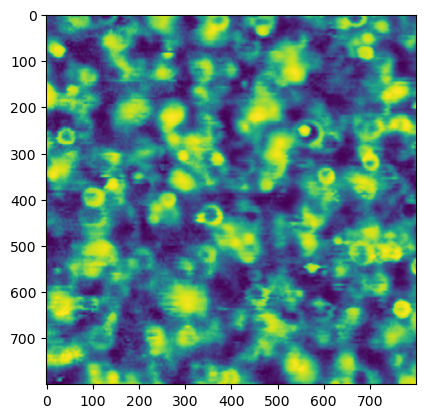

In [15]:
plt.imshow(clahe_result)

In [37]:
from scipy.ndimage import gaussian_filter

def bandpass_filter(img, sigma_small=1, sigma_large=5):
    # Apply Gaussian filters with different sigma values
    low_pass = gaussian_filter(img, sigma=sigma_large)
    very_low_pass = gaussian_filter(img, sigma=sigma_small)

    # Bandpass = difference between the two filtered images
    bandpass = low_pass - very_low_pass

    return bandpass

def find_components(img, bigger=False, threshold=0.6):
    # Create binary image
    if bigger:
        binary = (img > threshold).astype(np.uint8)
    else:
        binary = (img < threshold).astype(np.uint8)
    
    # Apply connected components
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(
        binary, 
        connectivity=8
    )
    
    # Create colored image for visualization
    label_hue = np.uint8(179 * labels / np.max(labels))
    blank_ch = 255 * np.ones_like(label_hue)
    labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
    labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2RGB)
    
    # Set background to black
    labeled_img[labels == 0] = 0
    
    return num_labels, labels, stats, centroids, labeled_img

def detect_donuts(binary_img):
    """
    Detect donut shapes in a binary image by finding contours with holes.
    
    Args:
        binary_img: Binary image (numpy array)
    Returns:
        donut_masks: List of binary masks for each detected donut
        stats: List of dictionaries containing donut properties
    """
    # Ensure image is binary and uint8
    if binary_img.dtype != np.uint8:
        binary_img = (binary_img * 255).astype(np.uint8)
    
    # Find contours with hierarchy information
    contours, hierarchy = cv2.findContours(
        binary_img, 
        cv2.RETR_CCOMP,  # Retrieves all contours and organizes them into a two-level hierarchy
        cv2.CHAIN_APPROX_SIMPLE
    )
    
    donut_masks = []
    stats = []
    
    if hierarchy is not None:
        hierarchy = hierarchy[0]  # hierarchy has shape (1, N, 4)
        
        for idx, (contour, hier) in enumerate(zip(contours, hierarchy)):
            # Check if contour has a child (hole)
            has_hole = hier[2] != -1  # hier[2] is index of first child
            
            if has_hole:
                # Create mask for this donut
                mask = np.zeros_like(binary_img)
                cv2.drawContours(mask, [contour], -1, 255, -1)
                
                # Calculate properties
                area = cv2.contourArea(contour)
                perimeter = cv2.arcLength(contour, True)
                circularity = (4 * np.pi * area) / (perimeter ** 2) if perimeter > 0 else 0
                
                # Store results
                donut_masks.append(mask)
                stats.append({
                    'area': area,
                    'perimeter': perimeter,
                    'circularity': circularity,
                    'center': tuple(np.mean(contour, axis=0)[0])
                })
    
    return donut_masks, stats





def multi_bandpass_and_thresh(img, sigmas=(2,20)):
    # apply median filter on img
    img = cv2.medianBlur(img, 5)

#    sigmas = [(2,20)]
    bandpassed = []
    # Apply bandpass filter with different sigma values
    for (sigma_small, sigma_large) in sigmas:
        print(f"Applying bandpass filter with sigma_small={sigma_small} and sigma_large={sigma_large}")
        bandpass = (bandpass_filter(img, sigma_small, sigma_large))
        # min-max normalise
        bandpass = min_max_normalize(bandpass)
        bandpassed.append(bandpass)
    # perform morphological closing
    for bandpass in bandpassed:
        # Convert image to uint8 if needed
        if bandpass.dtype != np.uint8:
            bandpass = (bandpass * 255).astype(np.uint8)
        kernel = make_kernel_radius_n(20)
        if kernel.dtype != np.uint8:
            kernel = (kernel * 255).astype(np.uint8)
        bandpass = cv2.morphologyEx(bandpass,cv2.MORPH_CLOSE, kernel, iterations=10)
    
    # find connected components in bandpassed[0]<0.65
    num_labels, labels, stats, centroids, labeled_img = find_components(bandpassed[0], threshold=0.65)

    component_stats = []
    circles = [] # circles
    donuts = []
    for label in range(1, num_labels):  # Skip background label 0
        # Create binary mask for current component
        component_mask = (labels == label).astype(np.uint8) * 255
        
        # Find the contour of the component
        contours, _ = cv2.findContours(component_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                
        if contours:
            # look for donuts
            donuts_, donut_stats = detect_donuts(component_mask)
            if donuts_ != []:
                for donut in donuts_:
                    donuts.append(component_mask)
            if donuts_ == []:            
                contour = contours[0]
                perimeter = cv2.arcLength(contour, True)
                area = stats[label, cv2.CC_STAT_AREA]
                
                # Avoid division by zero
                if perimeter > 0:
                    circularity = (4 * np.pi * area) / (perimeter ** 2)
                else:
                    circularity = 0
                
                component_stats.append({
                    'label': label,
                    'area': area,
                    'perimeter': perimeter,
                    'circularity': circularity,
                    'centroid': tuple(centroids[label])
                })
                if circularity > 0.9 and circularity<1.1:
                    circles.append(component_mask)                  
                    

    # go through circles and donuts and get rid of any that are very large area
    circles = [circle for circle in circles if np.sum(circle)<1000000]
    donuts = [donut for donut in donuts if np.sum(donut)<1000000]

    print(f'Found {len(circles)} circles and {len(donuts)} donuts')
    print('Found ', len(circles)+len(donuts), ' circles and donuts')
    # Display connected components
    if circles != []:
        img_circles = np.sum(circles, axis=0)
        img_circles = min_max_normalize(img_circles)
    else:
        img_circles = np.zeros_like(img_gray)
    if donuts !=[]:
        img_donuts = np.sum(donuts, axis=0)
        img_donuts = min_max_normalize(img_donuts)
    else:
        img_donuts = np.zeros_like(img_circles)

    img_circles = min_max_normalize(img_circles)
    
    chbp_ = clahe_bp_result.copy()
    chbp_ = min_max_normalize(chbp_)
    fig, ax = plt.subplots(1,3, figsize=(20,20))
    ax[0].imshow(img_circles, cmap='afmhot')
    ax[0].axis('off')
    ax[1].imshow(img_donuts, cmap='afmhot')
    ax[1].axis('off')
    ax[2].imshow(chbp_, cmap='afmhot')
    ax[2].axis('off')
    fig, ax = plt.subplots(1,2, figsize=(20,20))
    ax[0].imshow(img_circles+img_donuts+img_gray, cmap='afmhot')
    ax[0].axis('off')
    ax[1].imshow(img_gray)
    ax[1].axis('off')
    plt.show()
    
    return bandpassed

sigmas = [(2,4), (2,5), (2,6), (2,7), (2,8), (2,9), (2,10)]

for sigma in sigmas:
    bandpassed = multi_bandpass_and_thresh(img_gray.copy(), [sigma])



Applying bandpass filter with sigma_small=2 and sigma_large=4


NameError: name 'min_max_normalize' is not defined

In [ ]:
patches = pat.patchify(img_gray, (40, 40), step=40)

TypeError: Invalid shape (6, 800, 800) for image data

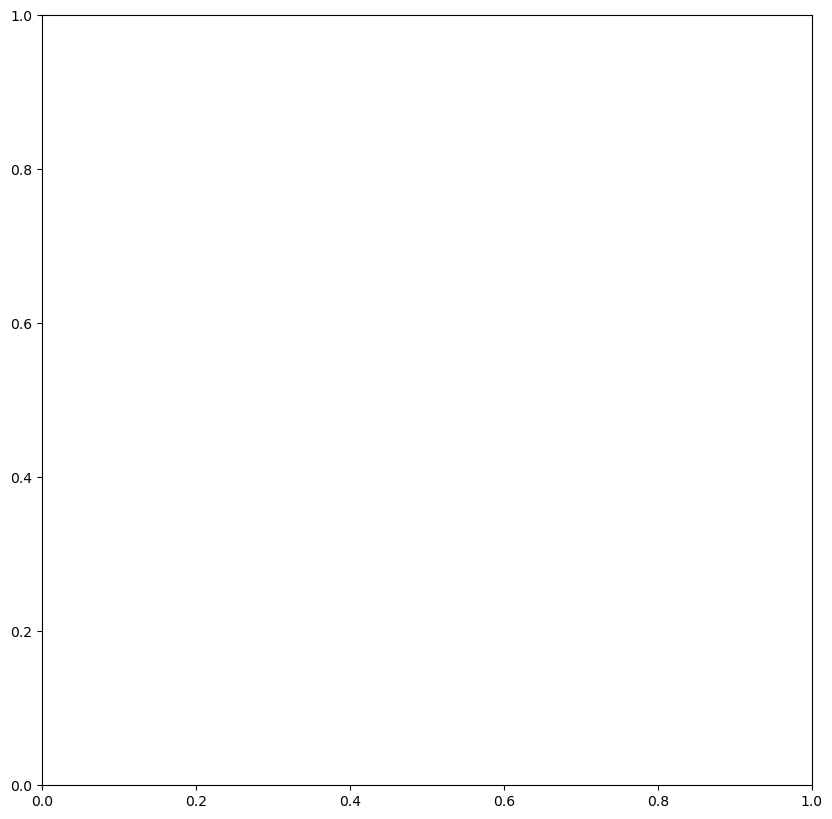

In [274]:
rings1, rings2 = find_rings(img_gray, 3)
plt.figure(figsize=(10,10))
plt.imshow(rings1, cmap='gray')
plt.axis("off")
plt.show()
plt.imshow((rings2<0.35)+(rings2>0.65), cmap='gray')
plt.axis("off")
plt.show()

In [35]:
def min_max_normalize(arr):
    arr_min = arr.min()
    arr_max = arr.max()
    return (arr - arr_min) / (arr_max - arr_min)

[0.41992188 0.5019531  0.5410156  0.5996094 ]


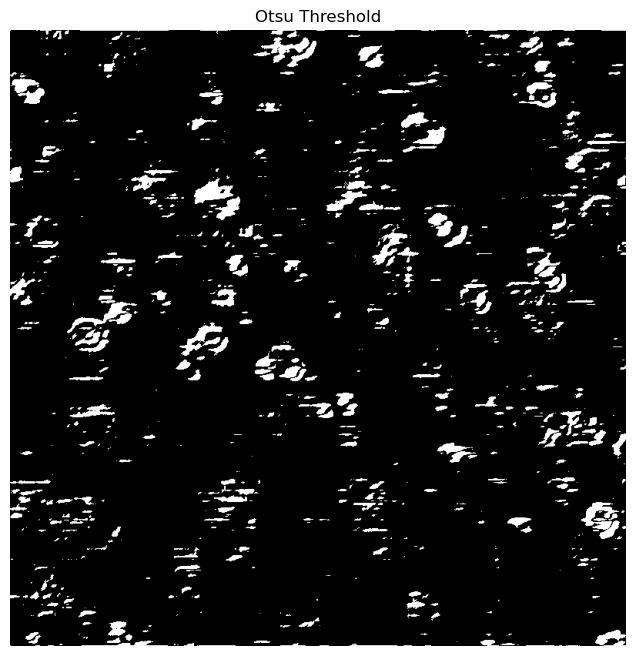

In [64]:
from skimage.filters import threshold_multiotsu

# Compute Otsu's threshold on rings2 and create a binary mask
thresholds = threshold_multiotsu(rings2, classes=5)
binary_otsu_upper = rings2 > thresholds[3]
binary_otsu_lower = rings2 < thresholds[0]
binary_otsu = binary_otsu_upper + binary_otsu_lower

print(thresholds)

plt.figure(figsize=(8,8))
plt.imshow(binary_otsu, cmap="gray")
plt.axis("off")
plt.title(f"Otsu Threshold")
plt.show()

In [76]:
import cv2

def find_circles(binary_image):
    # Convert to uint8 if not already
    if binary_image.dtype != np.uint8:
        binary_image = (binary_image * 255).astype(np.uint8)
    
    # Apply Hough Circle Transform
    circles = cv2.HoughCircles(
        binary_image,
        cv2.HOUGH_GRADIENT,
        dp=1,              # Inverse ratio of accumulator resolution
        minDist=10,        # Minimum distance between centers
        param1=70,         # Upper threshold for edge detection
        param2=40,         # Threshold for center detection
        minRadius=20,       # Minimum radius
        maxRadius=50       # Maximum radius
    )
    
    if circles is not None:
        # Convert coordinates to integers
        circles = np.uint16(np.around(circles))
        return circles[0]  # Returns array of [x, y, radius] for each circle
    return None

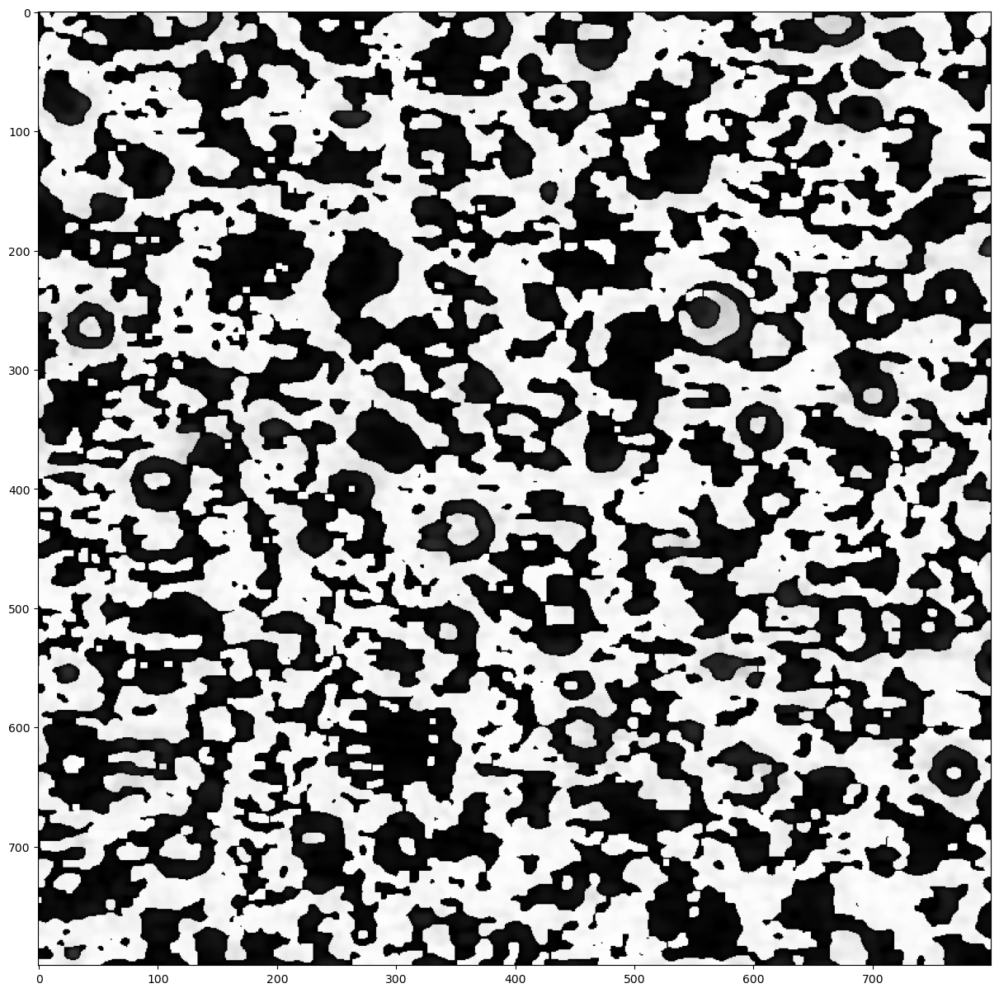

In [77]:
closed_img_ = closed_img.copy()
closed_img_ = closed_img_ * 255
closed_img_ = closed_img_.astype(np.uint8)

circles = find_circles(closed_img)
if circles is not None:
    print(len(circles))
    for x, y, r in circles:
        # Draw circle center
        cv2.circle(closed_img_, (x, y), 2, (0, 255, 0), 3)
        # Draw circle outline
        cv2.circle(closed_img_, (x, y), r, (0, 255, 0), 2)

plt.figure(figsize=(15,15))
plt.imshow(closed_img_, cmap='gray')
plt.show()

In [146]:
binary_otsu_ = binary_otsu.copy()
binary_otsu_ = binary_otsu_ * 255
binary_otsu_ = binary_otsu_.astype(np.uint8)

255


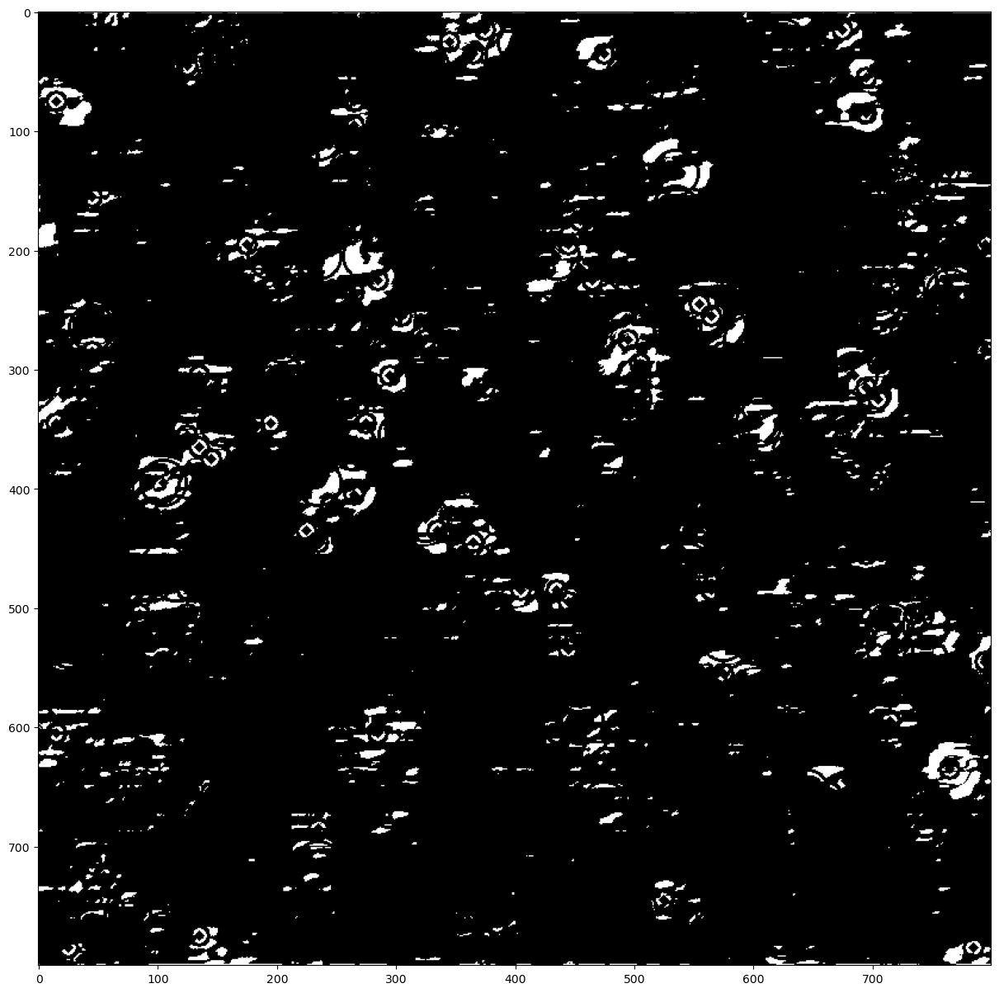

In [147]:
circles = find_circles(binary_otsu_)
if circles is not None:
    for x, y, r in circles:
        # Draw circle center
        cv2.circle(binary_otsu_, (x, y), 2, (0, 255, 0), 3)
        # Draw circle outline
        cv2.circle(binary_otsu_, (x, y), r, (0, 255, 0), 2)

print(len(circles))
plt.figure(figsize=(15,15))
plt.imshow(binary_otsu_, cmap='gray')
plt.show()

In [155]:
rings2_ = rings2.copy()
rings2_ = rings2_ * 255
rings2_ = rings2_.astype(np.uint8)


0
609


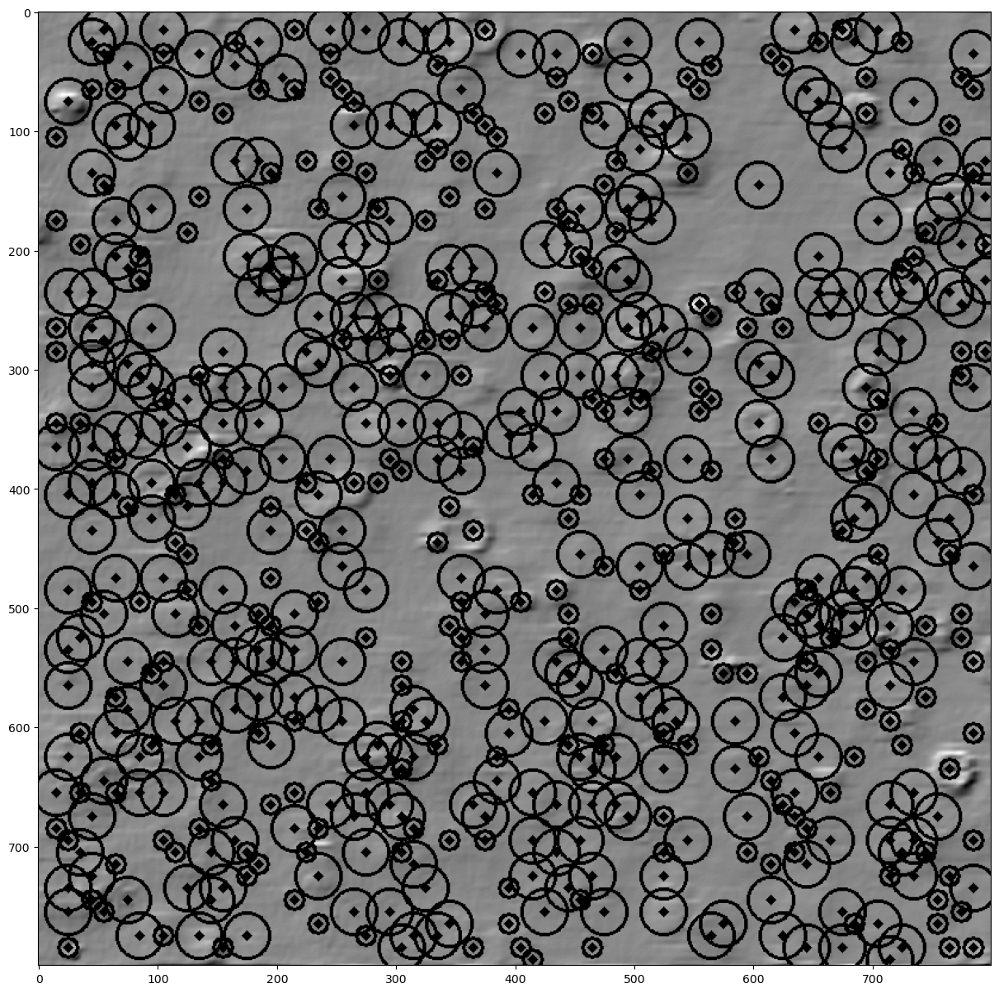

In [156]:
circles = find_circles(rings2_)
if circles is not None:
    print(0)
    for x, y, r in circles:
        # Draw circle center
        cv2.circle(rings2_, (x, y), 2, (0, 255, 0), 3)
        # Draw circle outline
        cv2.circle(rings2_, (x, y), r, (0, 255, 0), 2)

print(len(circles))
plt.figure(figsize=(15,15))
plt.imshow(rings2_, cmap='gray')
plt.show()


In [157]:
img_gray_ = img_gray.copy()
img_gray_ = (img_gray_ * 255).astype(np.uint8)

In [158]:
circles = find_circles(img_gray_)
if circles is not None:
    print(0)
    for x, y, r in circles:
        print(x,y)
        # Draw circle center
        cv2.circle(img_gray_, (x, y), 2, (0, 255, 0), 3)
        # Draw circle outline
        cv2.circle(img_gray_, (x, y), r, (0, 255, 0), 2)

0
355 435
105 395
725 525
45 265
275 215
185 205
295 365
305 625
355 35
715 345
455 225
435 515
535 755
25 365
35 635
75 625
755 175
235 715
65 645
605 355
515 135
135 335
575 255
455 595
675 345
715 195
505 285
235 415
265 435
525 295
145 785
25 165
135 395
745 235
705 515
525 95
105 435
295 245
785 535
275 645
315 305
535 305
695 485
735 625
745 545
145 365
335 435
35 155
235 235
465 195
465 245
725 235
505 305
255 425
705 15
235 695
395 435
755 205
105 635
405 495
495 595
715 165
295 305
325 415
205 215
435 485
775 235
35 775
265 105
715 75
125 635
335 15
25 75
695 55
475 285
615 15
465 35
725 595
755 515
125 325
645 15
465 175
665 35
25 275
765 635
265 85
45 715
595 565
765 545
785 505
15 345
55 755
535 85
615 385
45 295
435 165
45 745
275 265
375 315
695 85
735 365
145 305
485 615
575 545
705 315
295 655
665 645
375 15
725 505
45 395
465 535
485 205
625 365
715 295
285 605
535 125
305 335
735 205
335 305
515 675
705 245
275 625
735 175
325 375
635 605
295 575
625 325
725 305
775 6

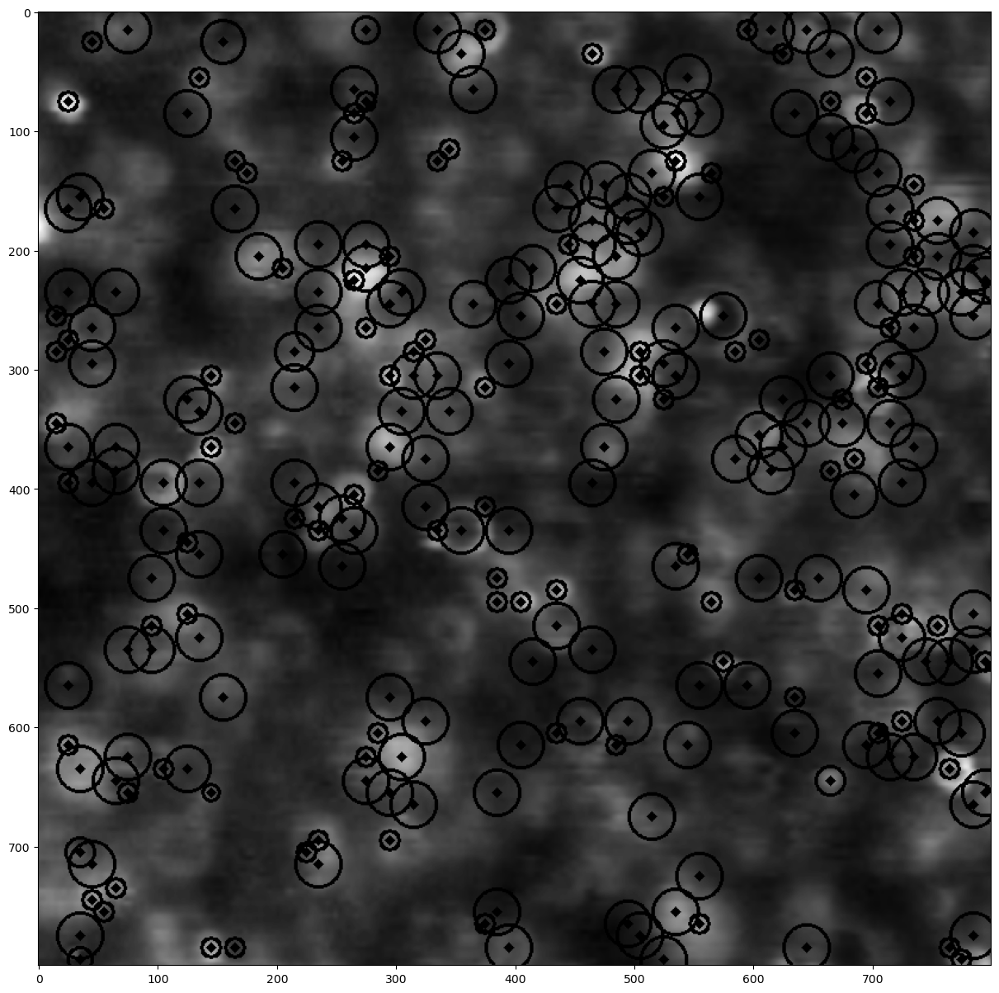

In [159]:
plt.figure(figsize=(15,15))
plt.imshow(img_gray_, cmap='gray')

(-0.5, 799.5, 799.5, -0.5)

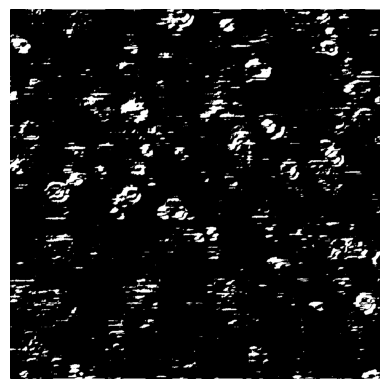

In [73]:
plt.imshow(binary_otsu, cmap='gray')
plt.axis("off") 
